In [ ]:
import os
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dataset_dir = "/content/drive/MyDrive/dataset_1"

train_dir = os.path.join(dataset_dir, "train")
valid_dir = os.path.join(dataset_dir, "val")
test_dir  = os.path.join(dataset_dir, "test")

print("Train:", os.listdir(train_dir))
print("Valid:", os.listdir(valid_dir))
print("Test:", os.listdir(test_dir))


Train: ['Phylosticta_LS_1000', 'Blight1000', 'Healthy_1000']
Valid: ['Phylosticta_LS_1000', 'Healthy_1000', 'Blight1000']
Test: ['Phylosticta_LS_1000', 'Healthy_1000', 'Blight1000']


In [ ]:
import pickle
all_results = {}
pickle_path = '/content/drive/MyDrive/dataset_1/segmentation_results.pkl'
if os.path.exists(pickle_path):
    with open(pickle_path, 'rb') as f:
        results = pickle.load(f)
    print("✅ Loaded results from pickle file.")
else:
    print("❌ Pickle file not found. Processing images...")

✅ Loaded results from pickle file.


In [ ]:
import tensorflow as tf

IMG_SIZE = (224, 224)
BATCH_SIZE = 32

train_ds = tf.keras.utils.image_dataset_from_directory(
    train_dir,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE
)

valid_ds = tf.keras.utils.image_dataset_from_directory(
    valid_dir,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE
)

test_ds = tf.keras.utils.image_dataset_from_directory(
    test_dir,
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE
)

normalization_layer = tf.keras.layers.Rescaling(1./255)
train_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
valid_ds = valid_ds.map(lambda x, y: (normalization_layer(x), y))
test_ds  = test_ds.map(lambda x, y: (normalization_layer(x), y))

Found 1625 files belonging to 3 classes.
Found 422 files belonging to 3 classes.
Found 174 files belonging to 3 classes.


In [ ]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomZoom(0.1),
])

# Example usage
augmented_ds = train_ds.map(lambda x, y: (data_augmentation(x), y))


In [ ]:
import cv2

In [ ]:
def basic_leaf_segmentation(img_path):
    # Read image
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Define green color range (tune if needed)
    lower_green = np.array([25, 40, 40])
    upper_green = np.array([85, 255, 255])
    # Create mask
    mask = cv2.inRange(hsv, lower_green, upper_green)
    # Apply mask
    segmented = cv2.bitwise_and(img, img, mask=mask)


    # store in pickle file
    # if filename not in all_results:
    #   all_results[filename] = {}
    # all_results[filename]["color_mask_light"] = mask
    # all_results[filename]["basic_segmented"] = segmented
    # all_results[filename]["original"] = img

    return img, mask, segmented

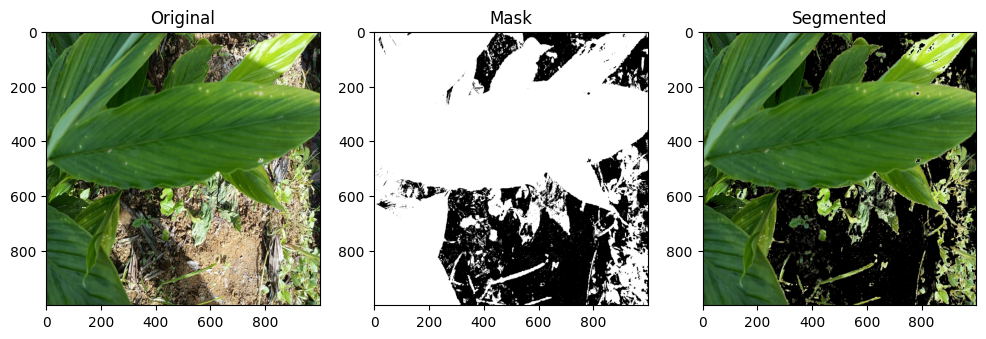

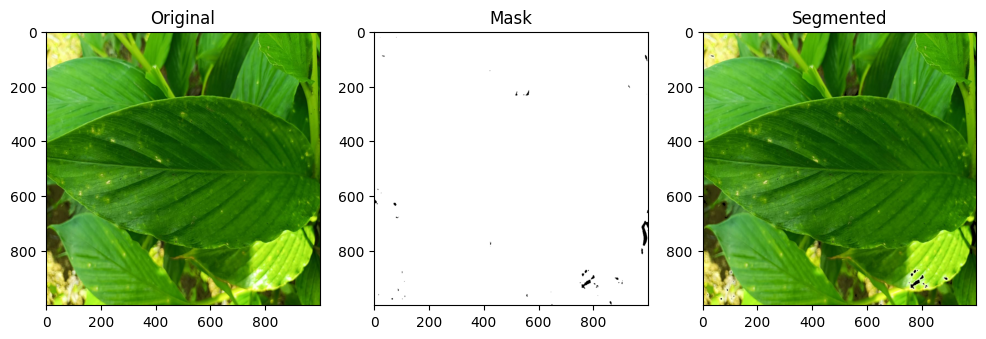

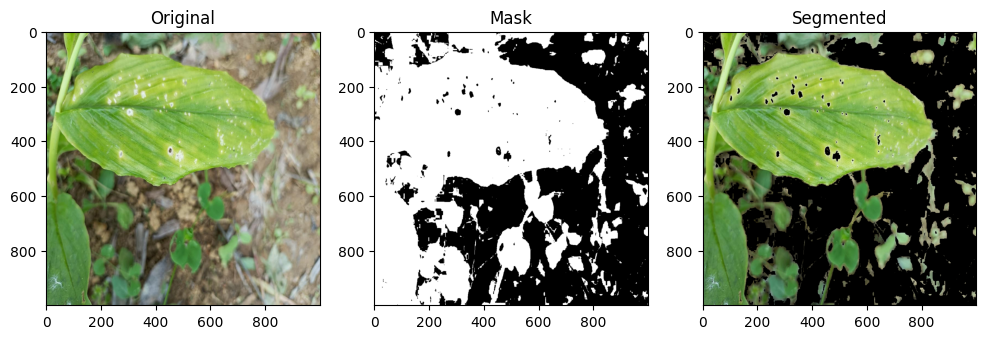

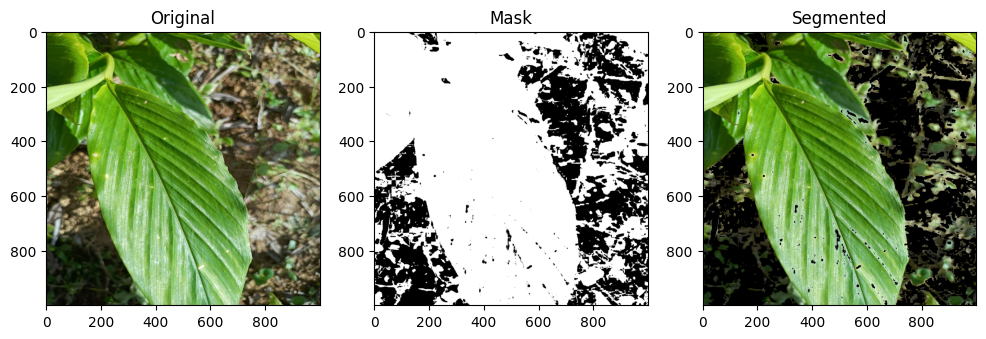

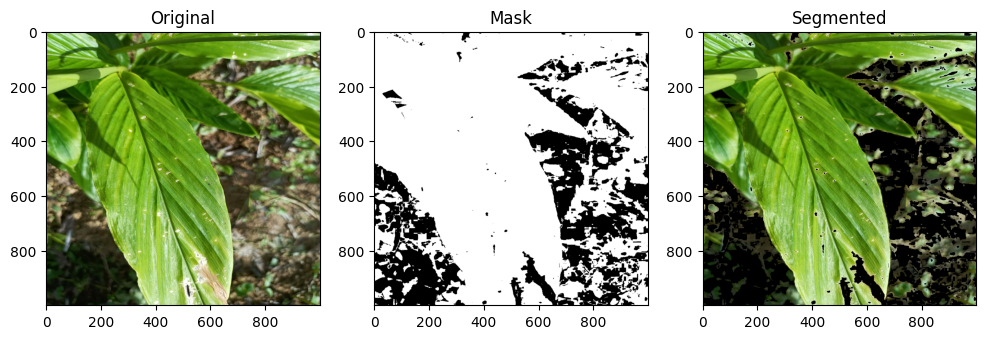

In [ ]:
sample_folder = os.path.join(valid_dir, "Phylosticta_LS_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = basic_leaf_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()


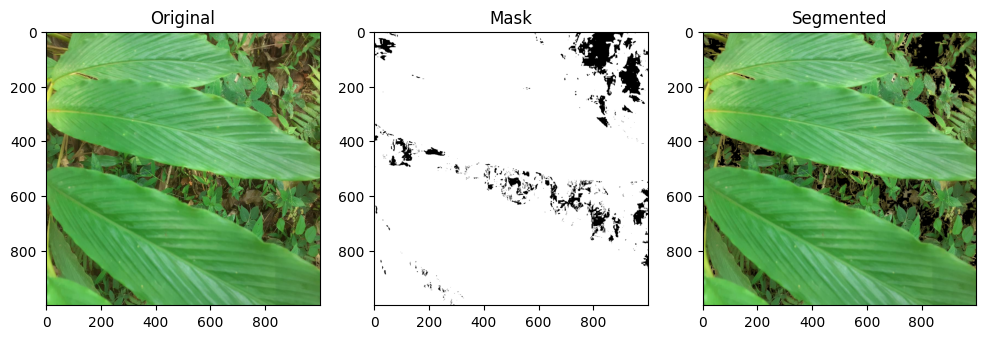

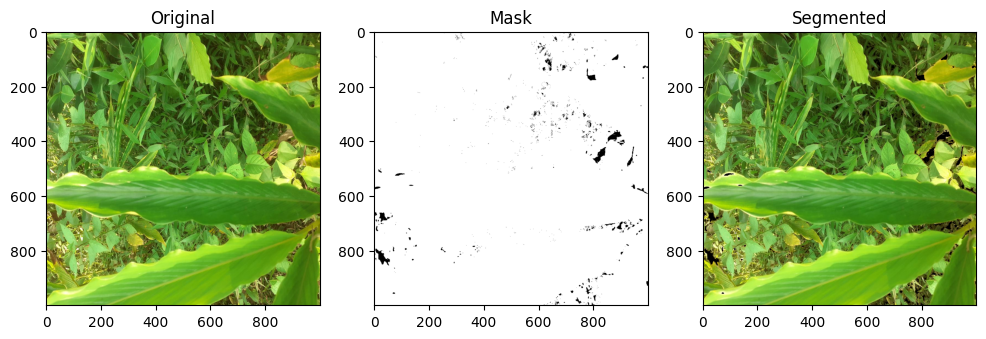

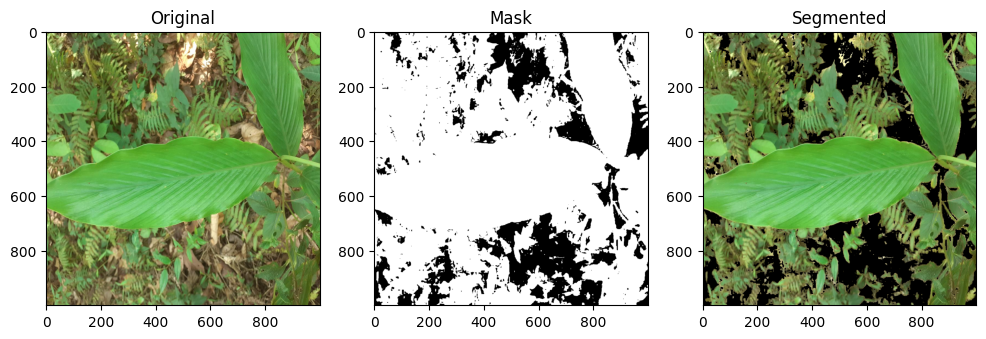

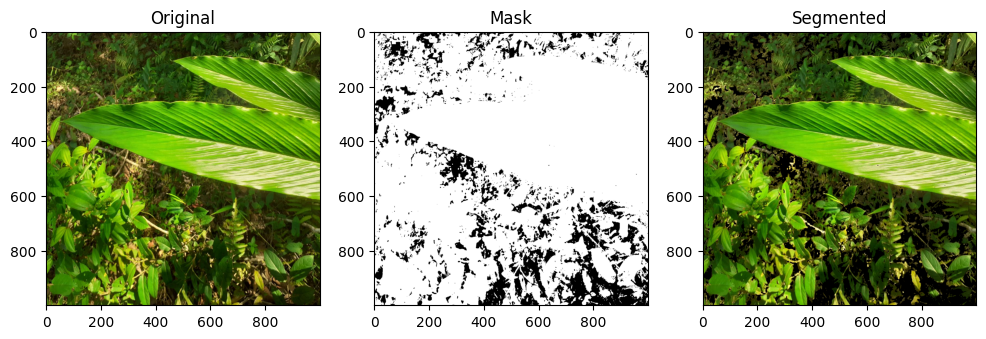

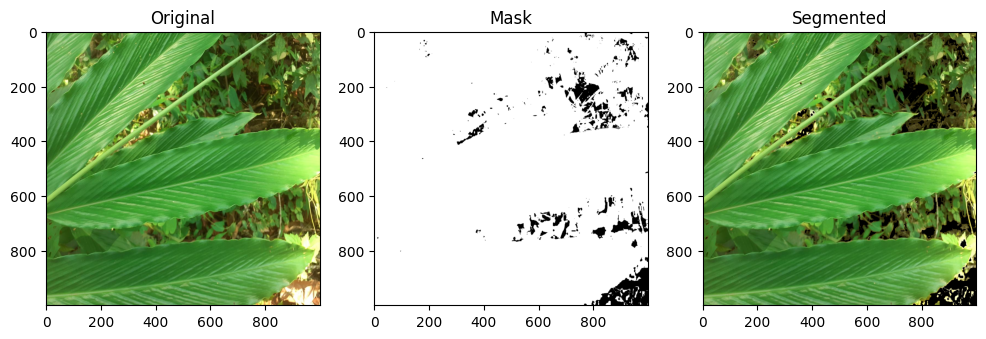

In [ ]:
sample_folder = os.path.join(valid_dir, "Healthy_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = basic_leaf_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()


In [ ]:
def super_strong_segmentation(img_path):
    # Read & convert
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

    # Tighter green range (tune if needed)
    lower_green = np.array([30, 40, 40])
    upper_green = np.array([255, 255, 255])

    mask = cv2.inRange(hsv, lower_green, upper_green)

    # Morphological operations to clean
    kernel = np.ones((7, 7), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)

    # Keep only the largest contour (main leaf)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        max_contour = max(contours, key=cv2.contourArea)
        mask = np.zeros_like(mask)
        cv2.drawContours(mask, [max_contour], -1, 255, thickness=cv2.FILLED)

    # Apply mask (force background to black)
    segmented = cv2.bitwise_and(img, img, mask=mask)

    # store result in pickle file
    # if filename not in all_results:
    #   all_results[filename] = {}
    # all_results[filename]["color_mask_strong"] = mask
    # all_results[filename]["strong_segmented_color"] = segmented
    # all_results[filename]["original_1"] = img
    return img, mask, segmented

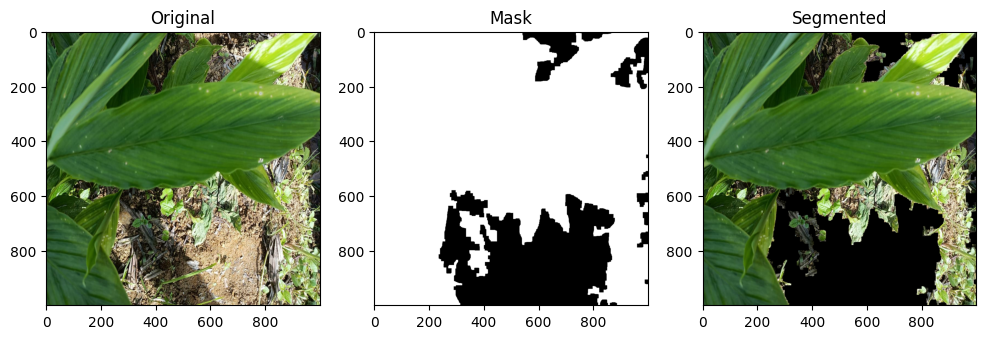

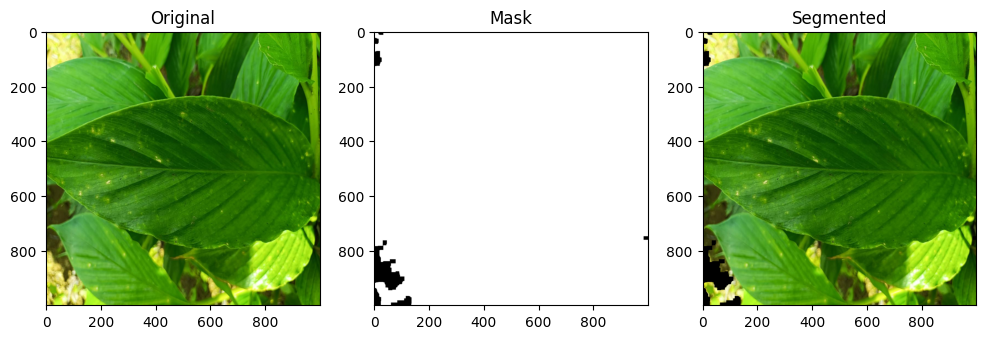

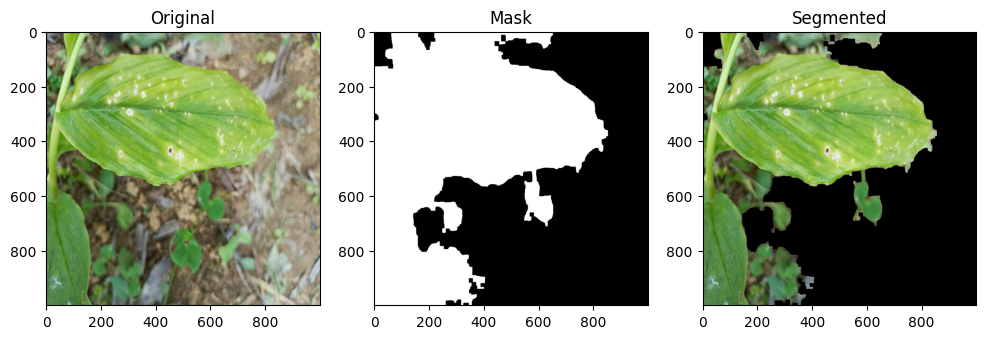

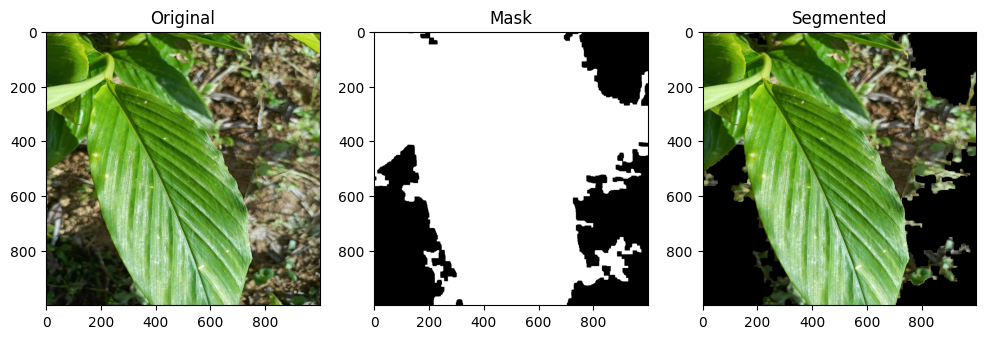

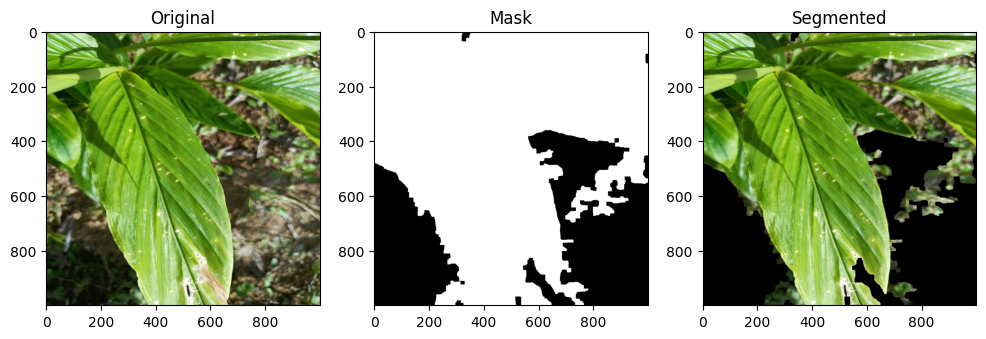

In [ ]:
sample_folder = os.path.join(valid_dir, "Phylosticta_LS_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = super_strong_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()


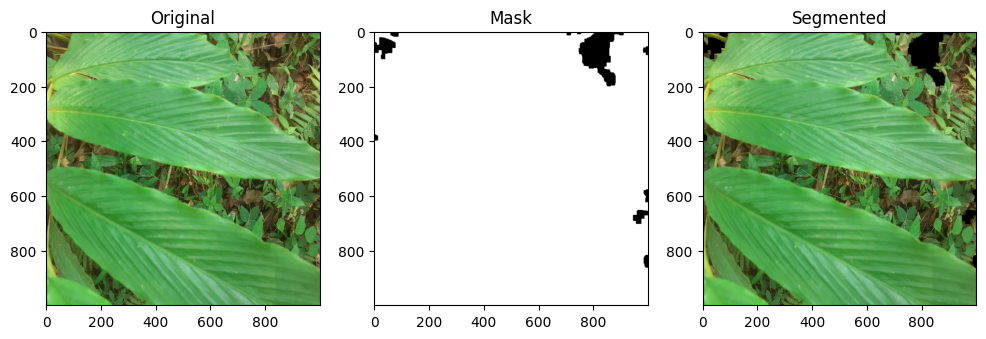

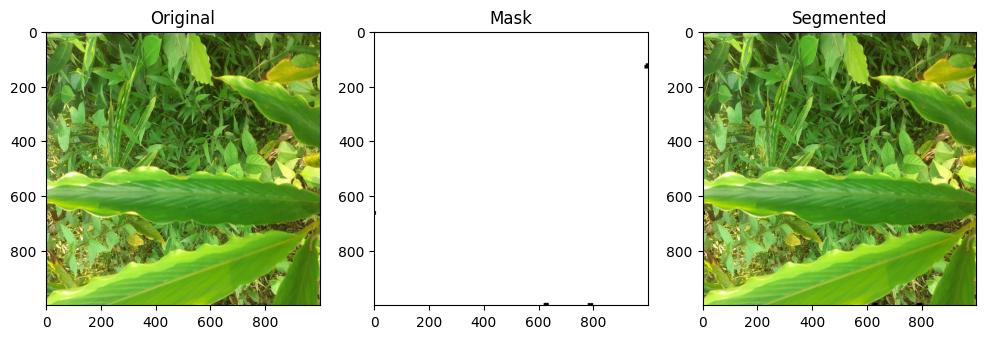

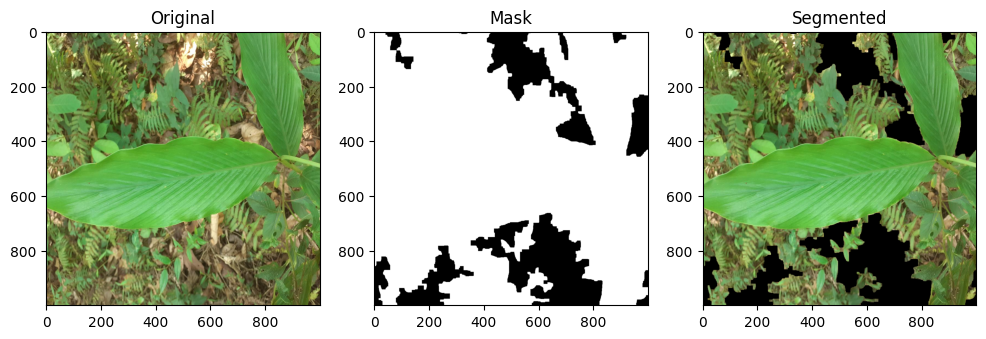

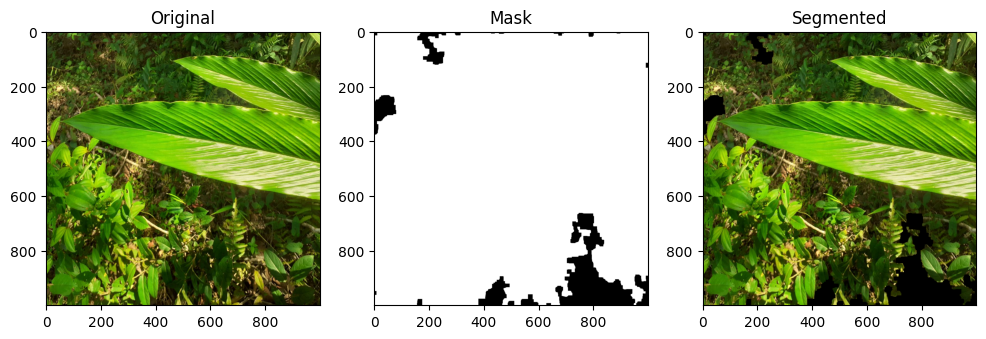

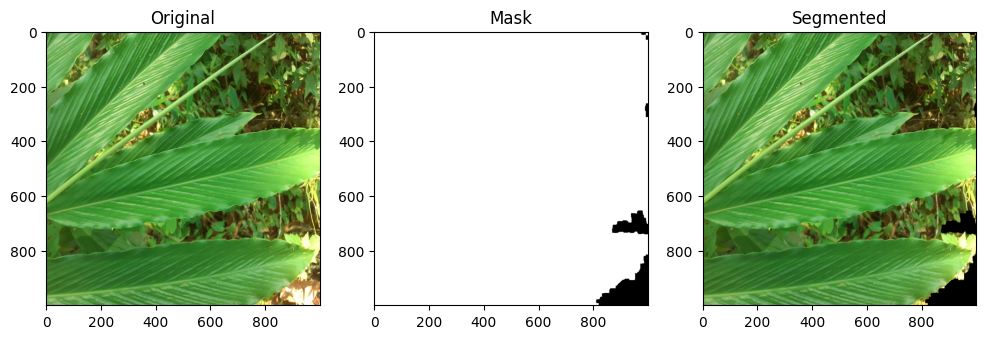

In [ ]:
sample_folder = os.path.join(valid_dir, "Healthy_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = super_strong_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()


------ Results upto to 22nd Sept 2025 --------


Edge Detection

In [ ]:
def edge_based_segmentation(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Convert to gray
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Apply Gaussian blur (reduces noise)
    blurred = cv2.GaussianBlur(gray, (5,5), 0)

    # Canny Edge Detection
    edges = cv2.Canny(blurred, threshold1=50, threshold2=150)

    # Find contours from edges
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Mask for the largest contour (the leaf outline)
    mask = np.zeros_like(gray)
    if contours:
        max_contour = max(contours, key=cv2.contourArea)
        cv2.drawContours(mask, [max_contour], -1, 255, thickness=cv2.FILLED)

    # Apply mask
    segmented = cv2.bitwise_and(img, img, mask=mask)

    # store in pickle file
    # if filename not in all_results:
    #   all_results[filename] = {}
    # all_results[filename]["color_mask_ed"] = mask
    # all_results[filename]["ed_segmented_color"] = segmented
    # all_results[filename]["edges"] = edges
    # all_results[filename]["original_2"] = img
    return img, edges, segmented

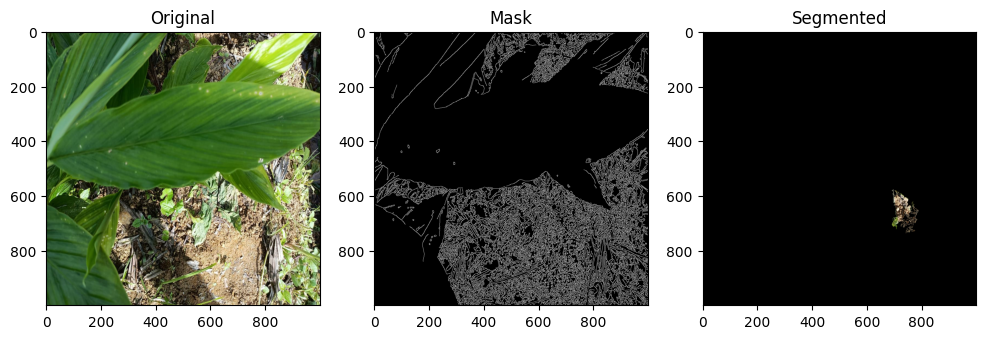

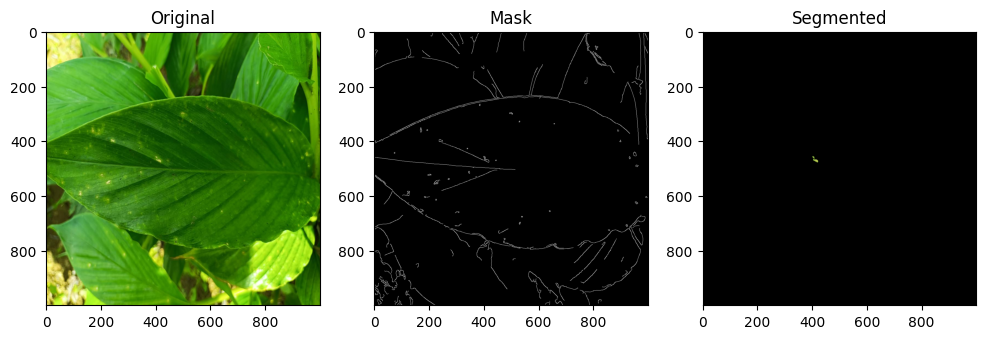

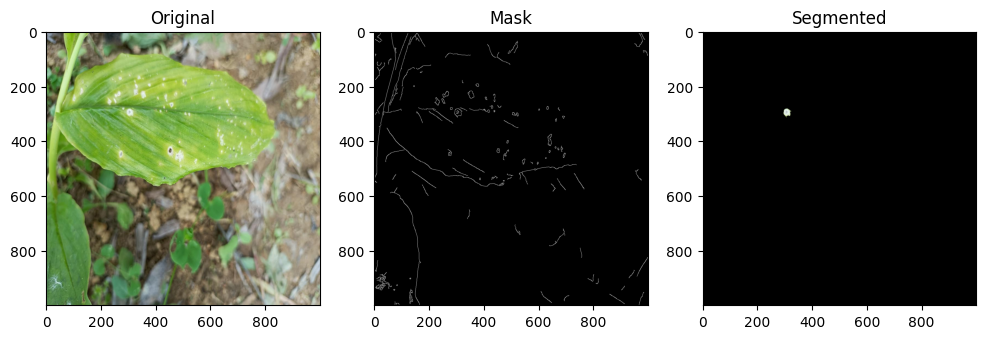

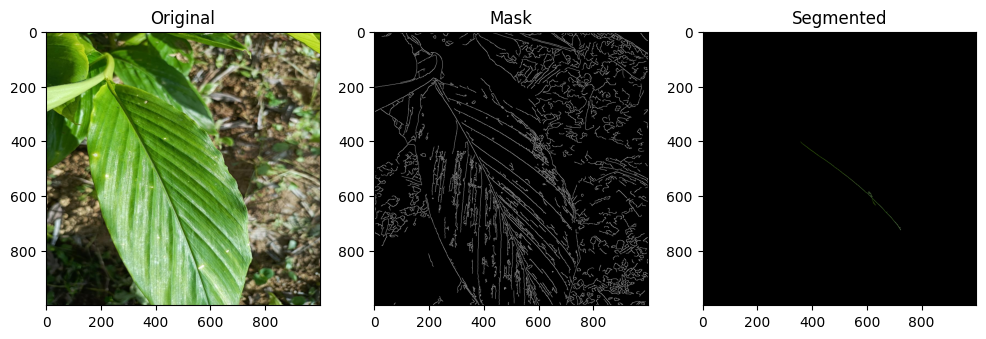

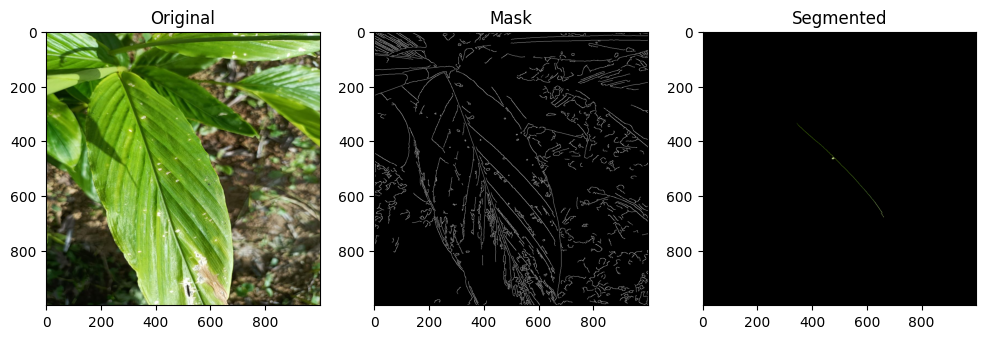

In [ ]:
sample_folder = os.path.join(valid_dir, "Phylosticta_LS_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = edge_based_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()

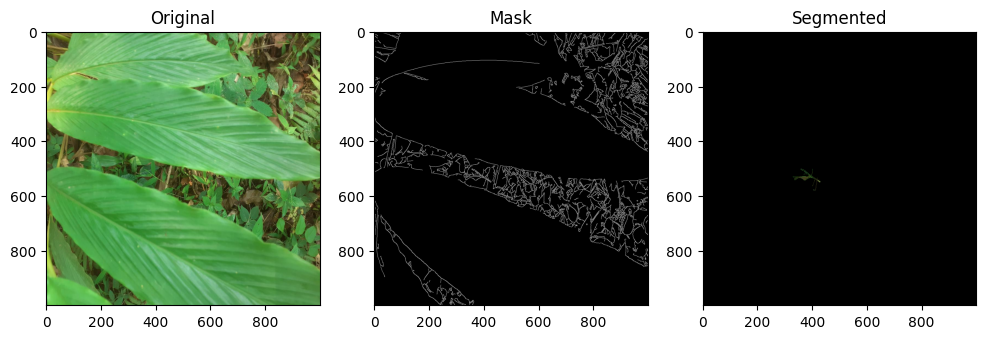

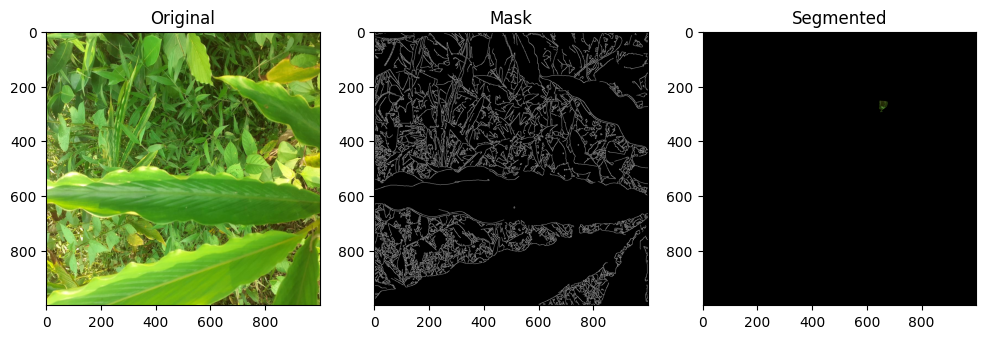

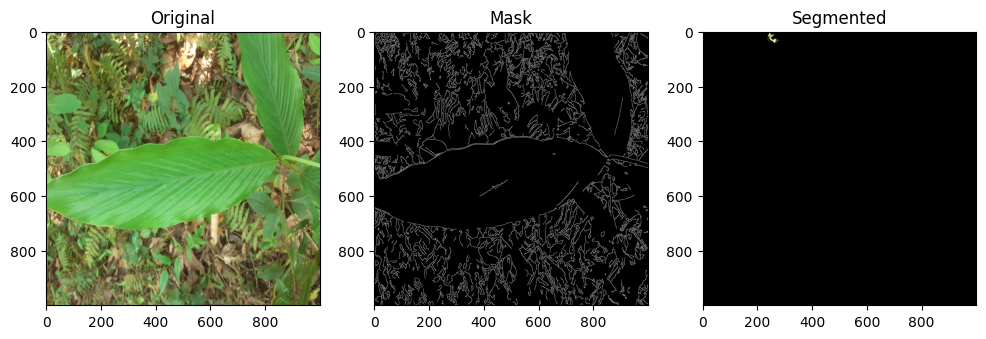

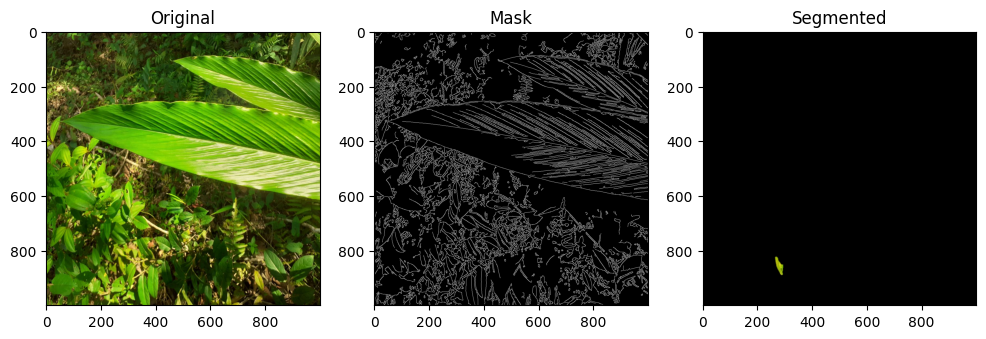

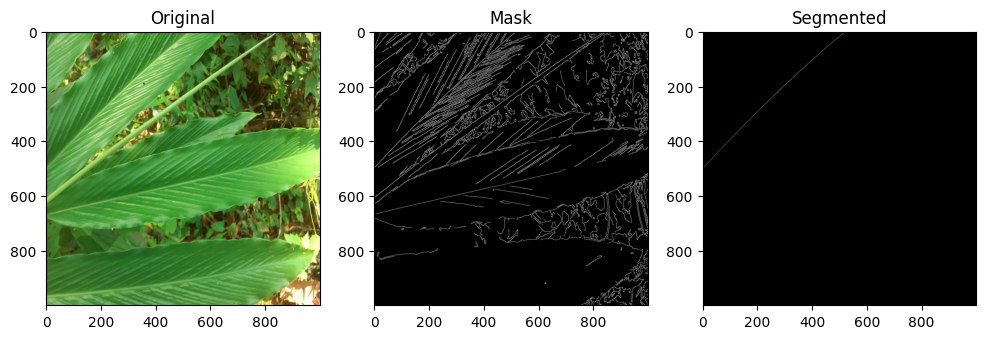

In [ ]:
sample_folder = os.path.join(valid_dir, "Healthy_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = edge_based_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()

In [ ]:
def improved_ed_segmentation(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Convert to gray
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    blurred = cv2.GaussianBlur(gray, (5,5), 0)
    # Canny edges
    edges = cv2.Canny(blurred, 50, 150)
    # Contours
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    mask = np.zeros_like(gray)
    if contours:
        max_contour = max(contours, key=cv2.contourArea)
        cv2.drawContours(mask, [max_contour], -1, 255, thickness=cv2.FILLED)
    # Apply mask
    segmented = cv2.bitwise_and(img, img, mask=mask)
    # Brightness & contrast enhancement
    segmented = cv2.convertScaleAbs(segmented, alpha=1.5, beta=40)
    # alpha=contrast (>1 stronger), beta=brightness
    # store in pickle file
    # if filename not in all_results:
    #   all_results[filename] = {}
    # all_results[filename]["color_mask_edimp"] = mask
    # all_results[filename]["edimp_segmented_color"] = segmented
    # all_results[filename]["edges_imp"] = edges
    # all_results[filename]["original_3"] = img
    return img, edges, segmented

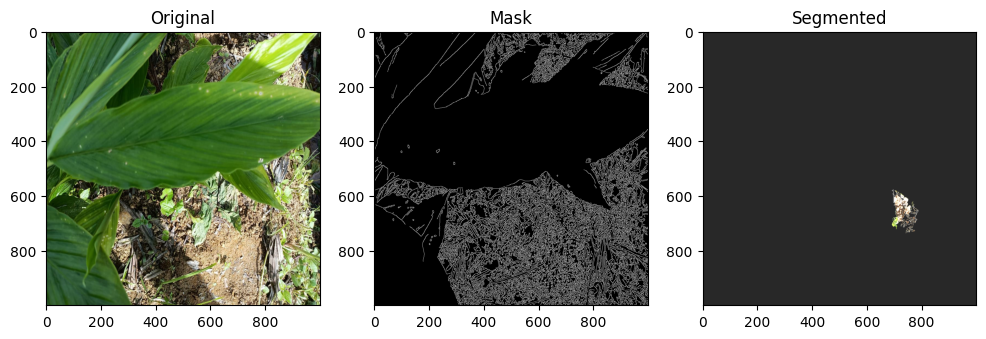

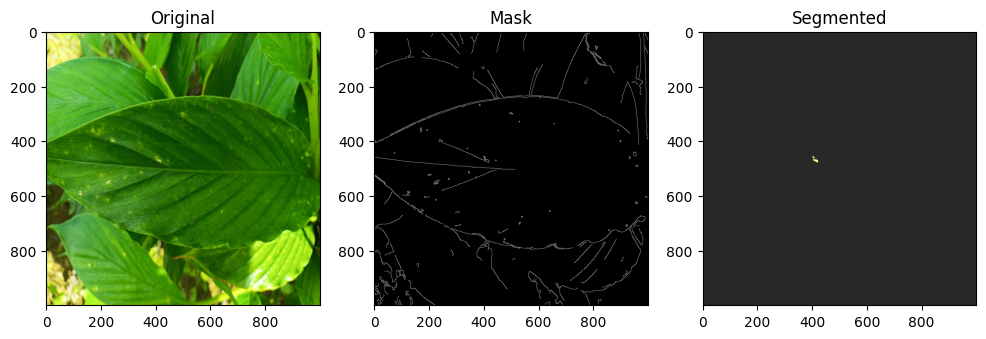

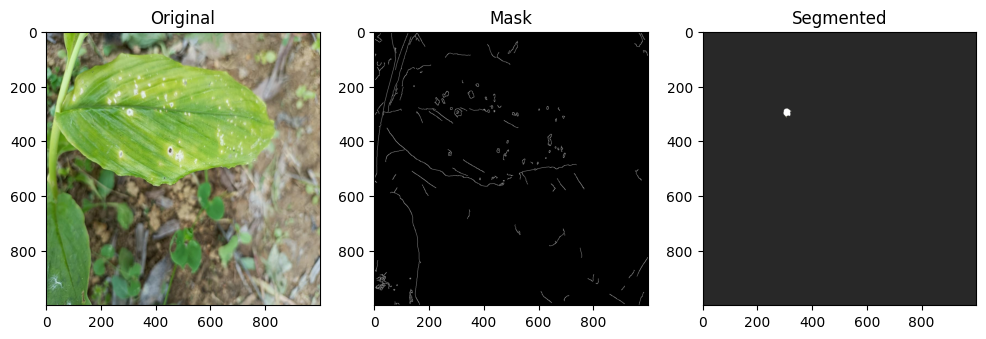

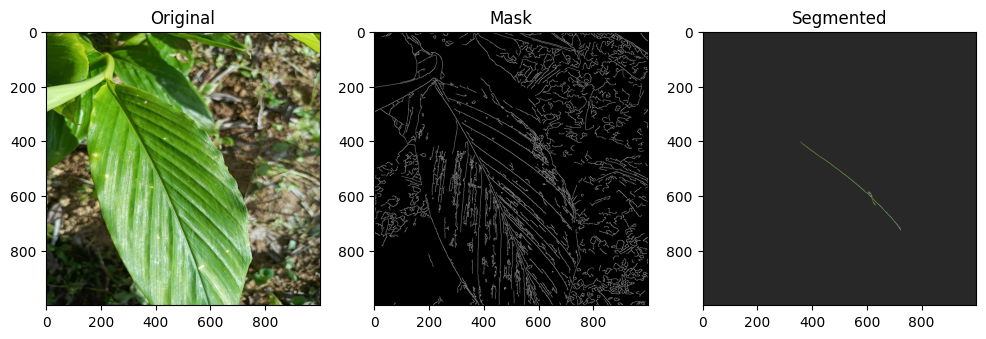

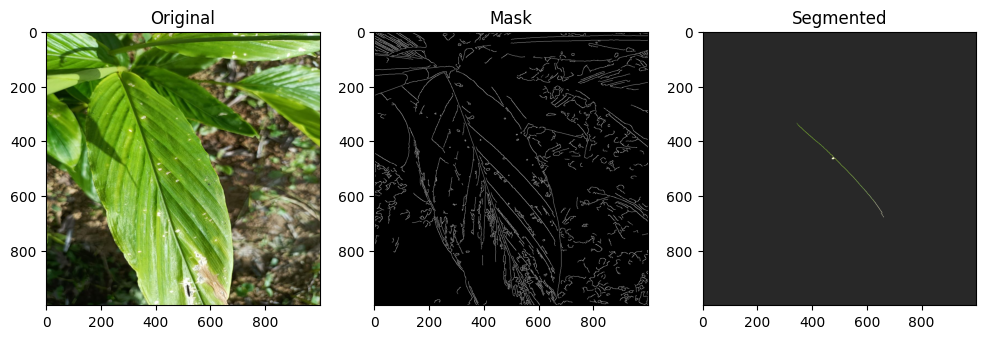

In [ ]:
sample_folder = os.path.join(valid_dir, "Phylosticta_LS_1000")
for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = improved_ed_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()

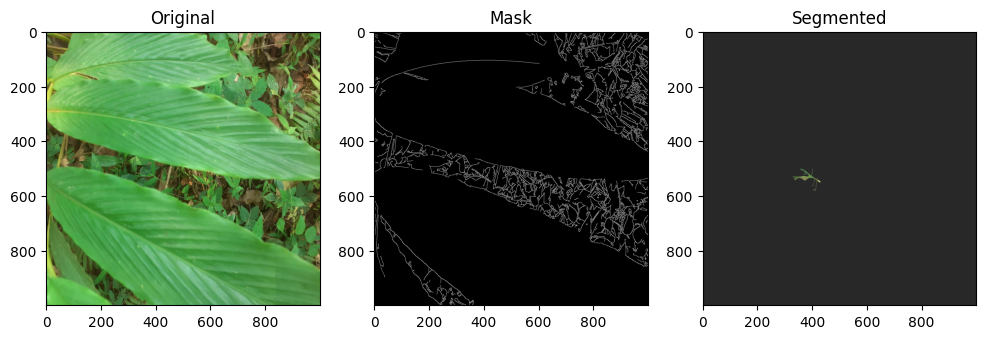

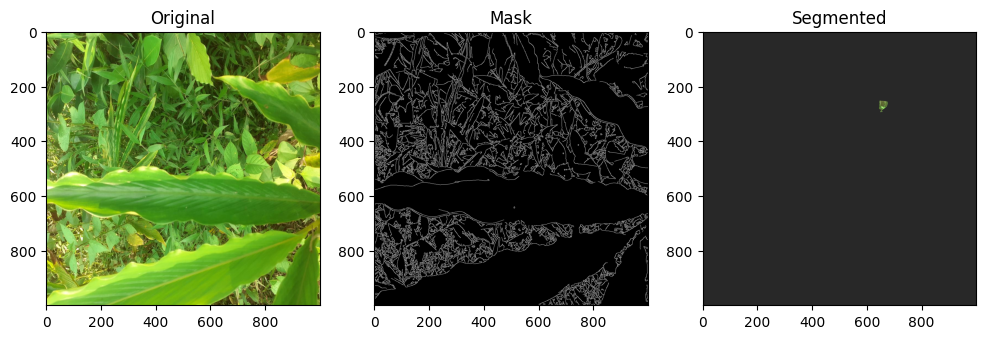

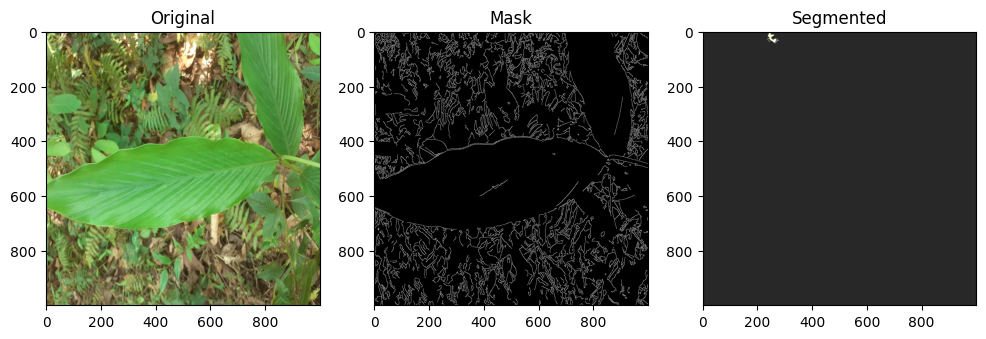

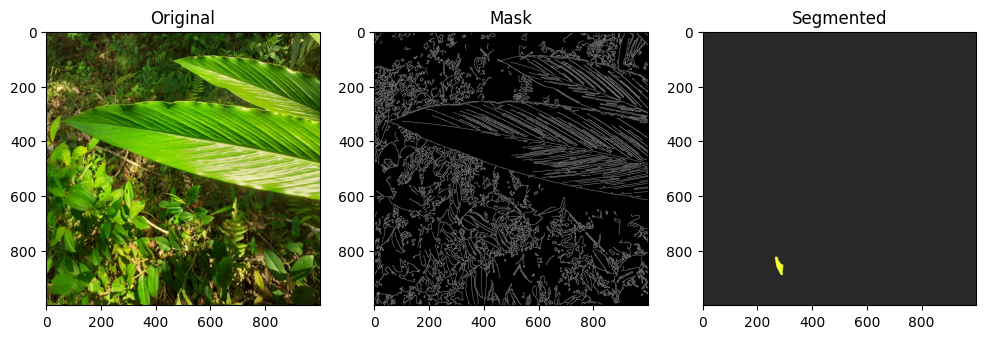

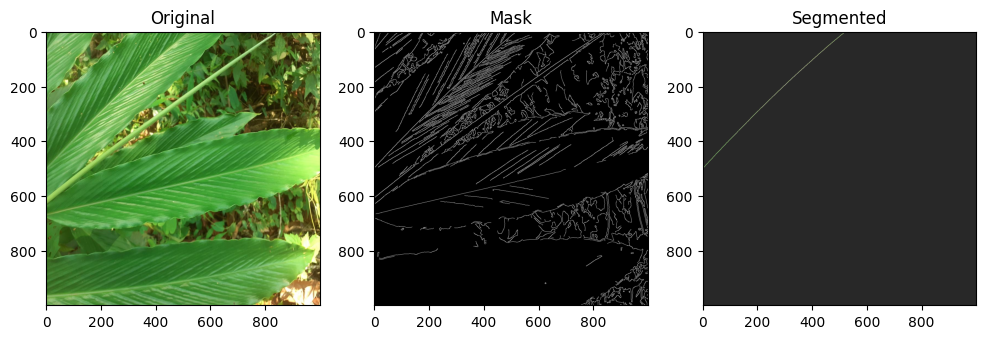

In [ ]:
sample_folder = os.path.join(valid_dir, "Healthy_1000")
for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, mask, segmented = improved_ed_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,3,2); plt.imshow(mask, cmap="gray"); plt.title("Mask")
    plt.subplot(1,3,3); plt.imshow(segmented); plt.title("Segmented")
    plt.show()

In [ ]:
def kmeans_segmentation(img_path, K=3):
    # Read image
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Reshape into (pixels, 3)
    Z = img.reshape((-1, 3))
    Z = np.float32(Z)
    # Define KMeans criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
    # Run KMeans
    _, labels, centers = cv2.kmeans(Z, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    centers = np.uint8(centers)
    segmented_data = centers[labels.flatten()]
    segmented_img = segmented_data.reshape(img.shape)

    # if filename not in all_results:
    #   all_results[filename] = {}
    # all_results[filename]["kmeans_segmented_color"] = segmented
    # all_results[filename]["original_4"] = img

    return img, segmented_img


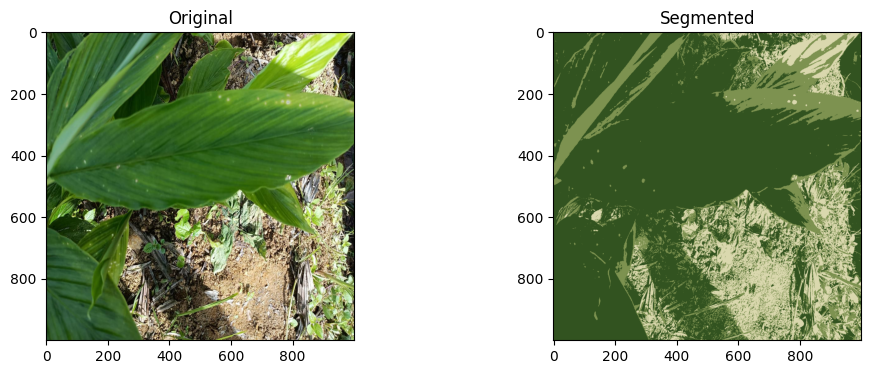

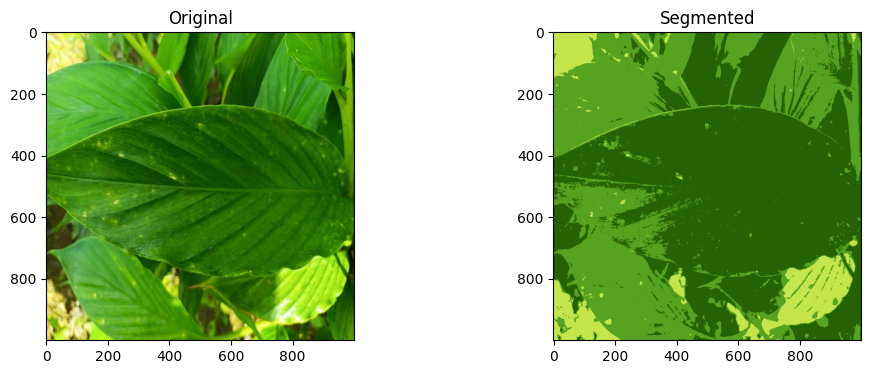

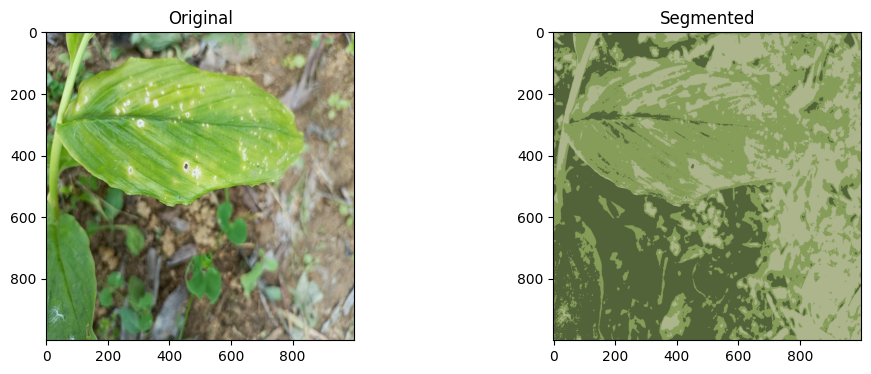

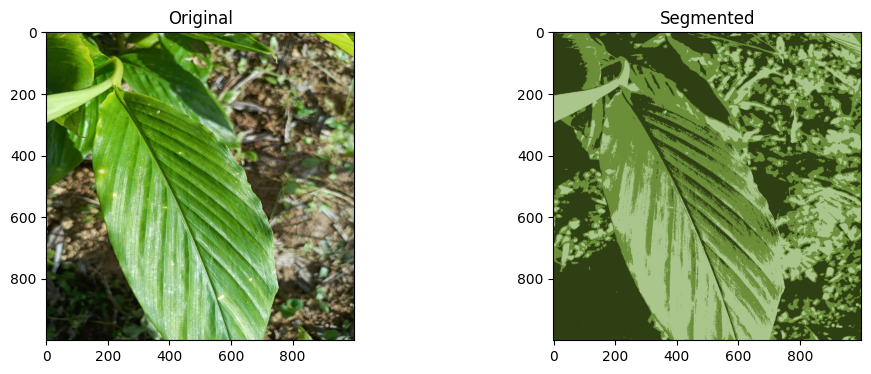

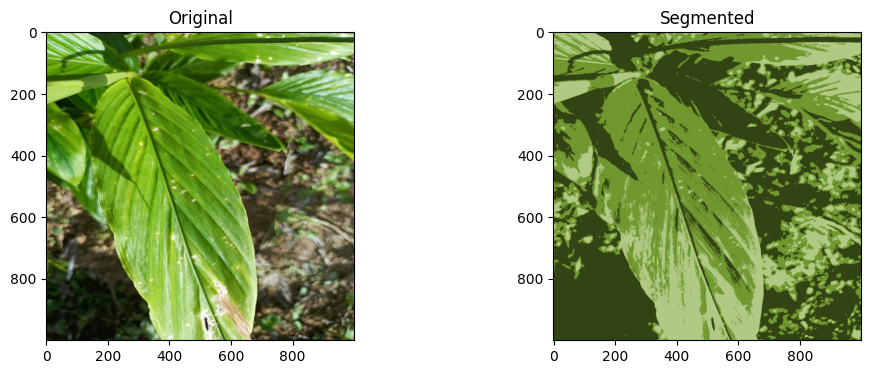

In [ ]:
sample_folder = os.path.join(valid_dir, "Phylosticta_LS_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, segmented = kmeans_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,2,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,2,2); plt.imshow(segmented); plt.title("Segmented")
    plt.show()

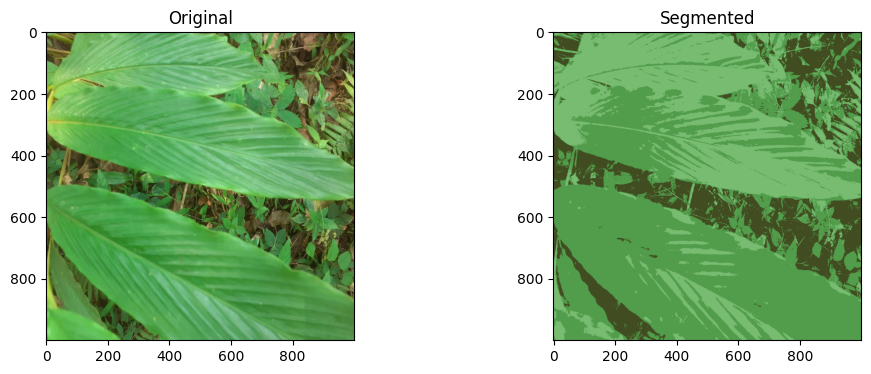

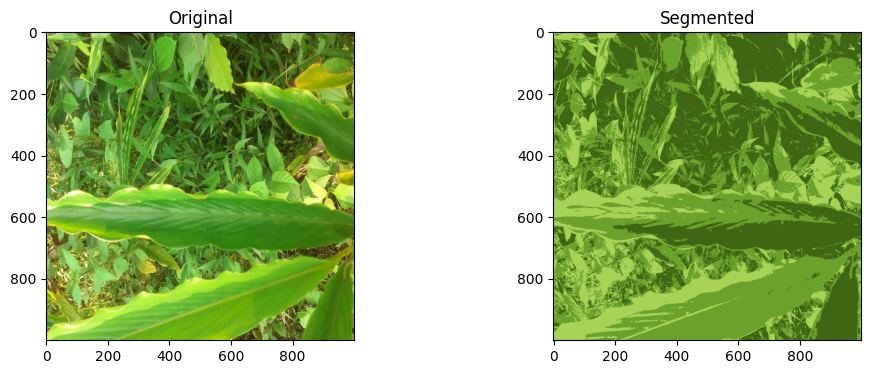

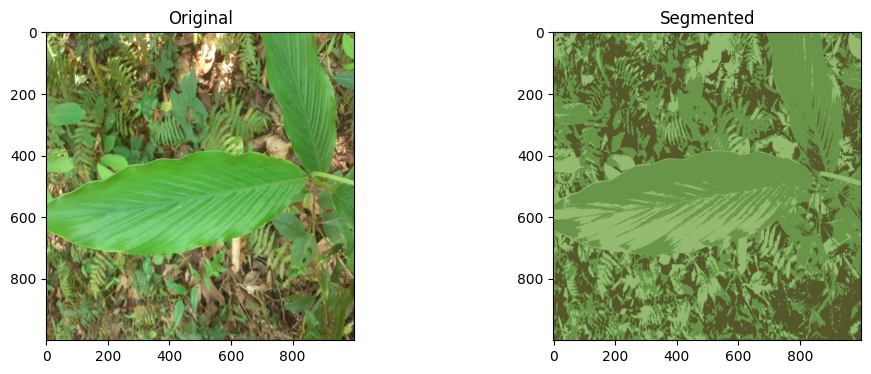

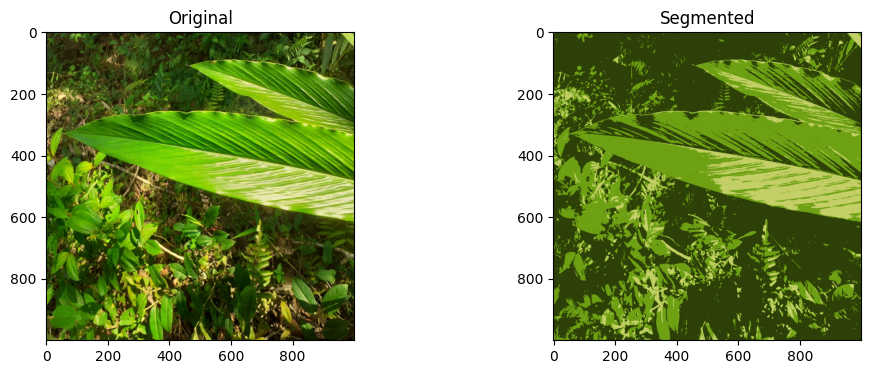

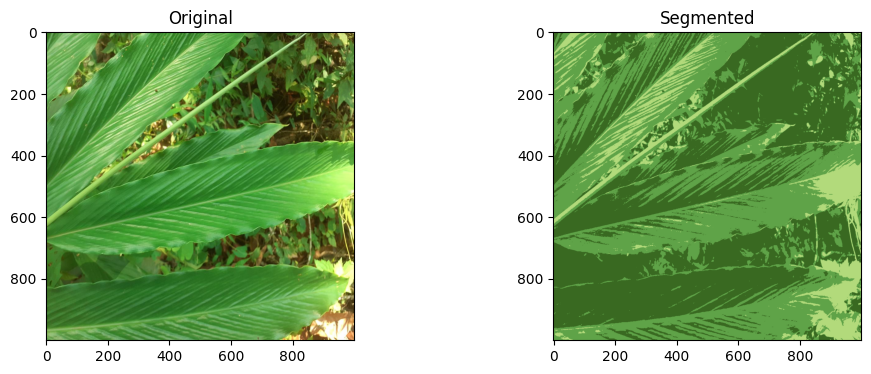

In [ ]:
sample_folder = os.path.join(valid_dir, "Healthy_1000")

for i, file in enumerate(os.listdir(sample_folder)[:5]):  # first 5 images
    img_path = os.path.join(sample_folder, file)
    original, segmented = kmeans_segmentation(img_path)

    plt.figure(figsize=(12,4))
    plt.subplot(1,2,1); plt.imshow(original); plt.title("Original")
    plt.subplot(1,2,2); plt.imshow(segmented); plt.title("Segmented")
    plt.show()

U2 Net

In [ ]:
# import torch
# from model import U2NET # from the cloned U-2-Net repo
# net = U2NET(3, 1) # 3 input channels, 1 output channel
# state_dict = torch.load(weight_path, map_location="cpu")
# net.load_state_dict(state_dict)
# net.eval()
# print("✅ U2Net loaded successfully")

In [ ]:
import pickle
import torch

weight_path = "/content/drive/MyDrive/U2Net_weights/u2net.pth"  # file you just uploaded
# pickle_path = "/content/drive/MyDrive/U2Net_weights/u2net_weights.pkl"

# Load raw weights once
state_dict = torch.load(weight_path, map_location="cpu")

# Save inside pickle
# with open(pickle_path, 'wb') as f:
#     pickle.dump(state_dict, f)

print(f"u2net.pth saved inside pickle file: {pickle_path}")

u2net.pth saved inside pickle file: /content/drive/MyDrive/dataset_1/segmentation_results.pkl


In [ ]:
# Get the official U²-Net repo
!git clone https://github.com/xuebinqin/U-2-Net.git
import sys
sys.path.append("/content/U-2-Net")  # add repo to path


fatal: destination path 'U-2-Net' already exists and is not an empty directory.


In [ ]:
from model.u2net import U2NET
from torchvision import transforms

# Paths
weight_path = "/content/drive/MyDrive/U2Net_weights/u2net.pth"
image_folder = "/content/drive/MyDrive/dataset_1/test/Healthy_1000"

# Load U²-Net
net = U2NET(3, 1)
state_dict = torch.load(weight_path, map_location="cpu")
net.load_state_dict(state_dict)
net.eval()
print("U2Net loaded successfully")

# Preprocessing
transform = transforms.Compose([
    transforms.Resize((320, 320)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406),
                         (0.229, 0.224, 0.225))
])

image_list = [f for f in os.listdir(image_folder) if f.lower().endswith((".jpg", ".jpeg", ".png"))][:10]

U2Net loaded successfully


Processing (1/5): Healthy (292).jpg


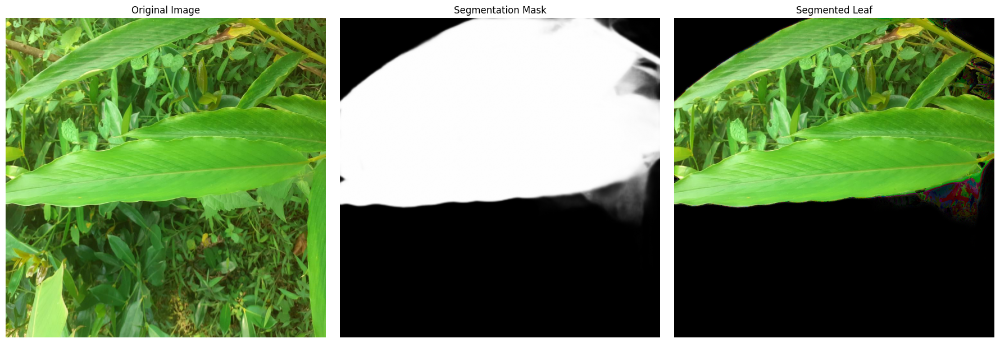

Processing (2/5): Healthy (199).jpg


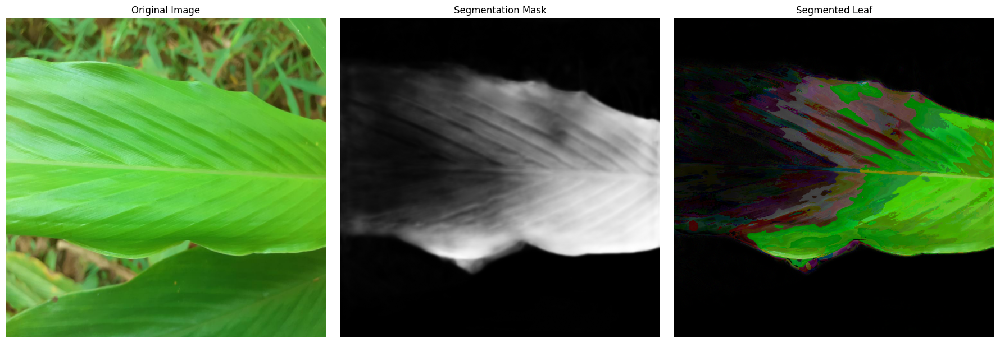

Processing (3/5): Healthy (221).jpg


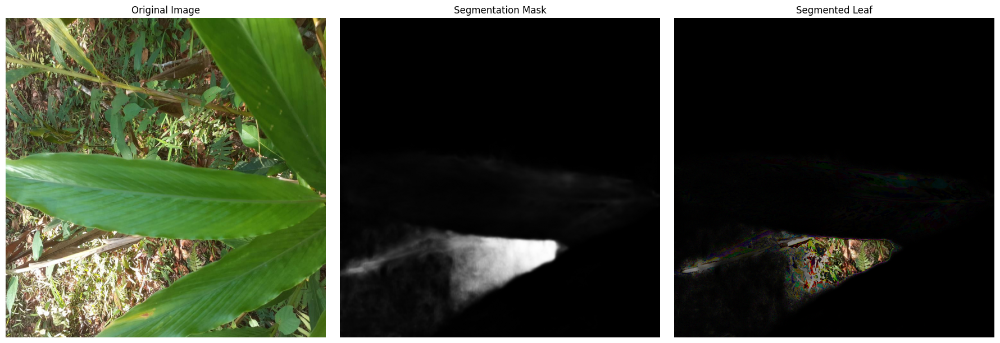

Processing (4/5): Healthy (272).jpg


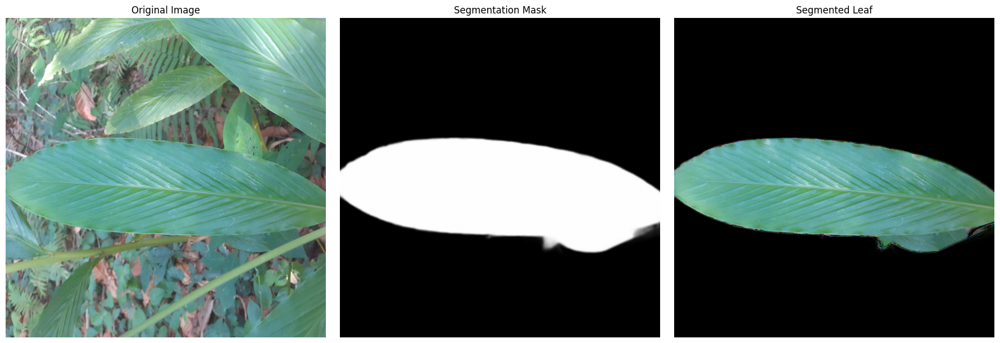

Processing (5/5): Healthy (283).jpg


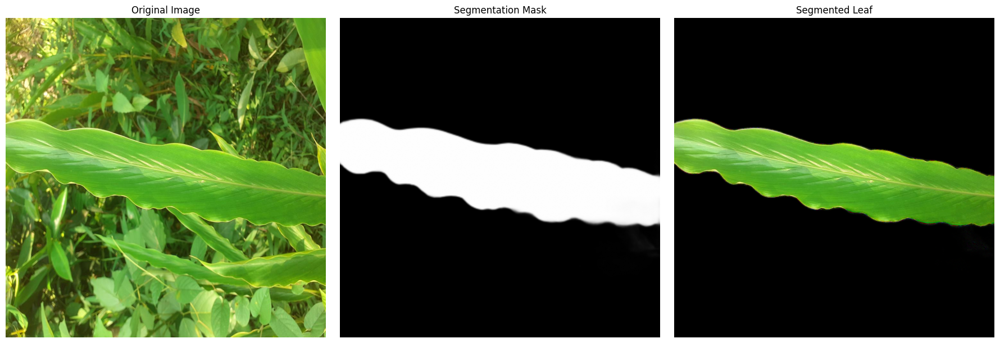

Processing (6/5): Healthy (271).jpg


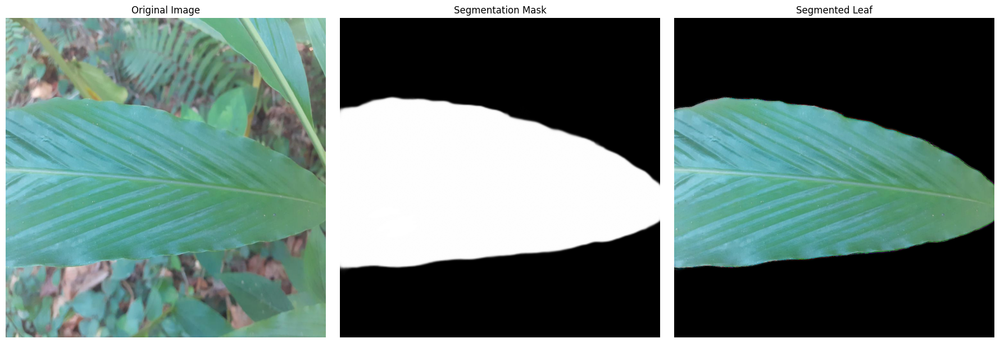

Processing (7/5): Healthy (142).jpg


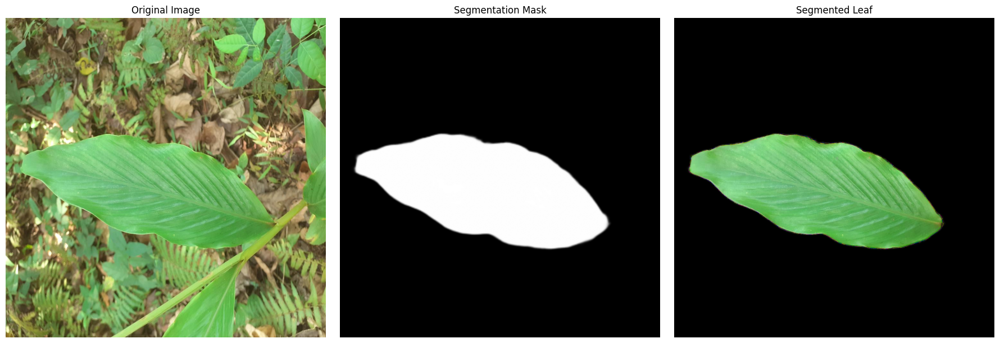

Processing (8/5): Healthy (219).jpg


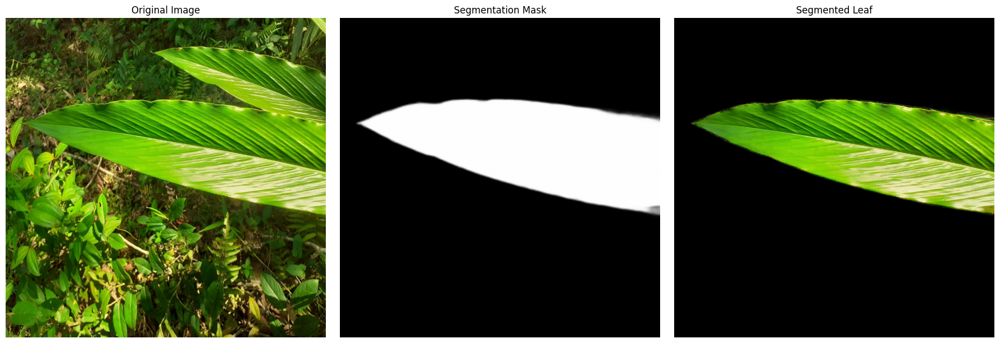

Processing (9/5): Healthy (185).jpg


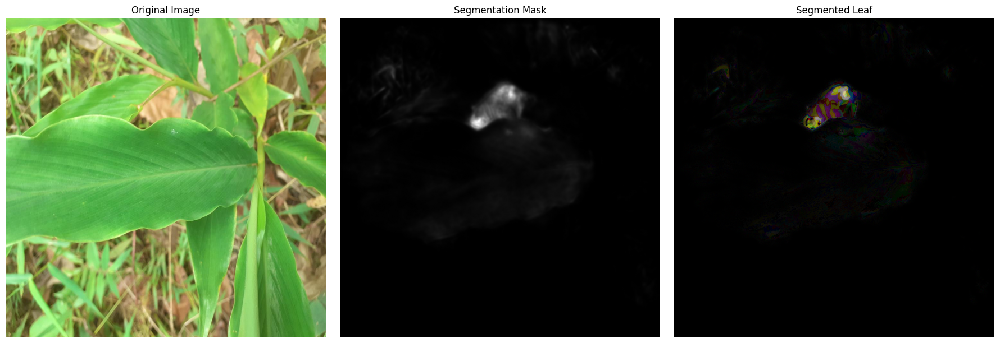

Processing (10/5): Healthy (250).jpg


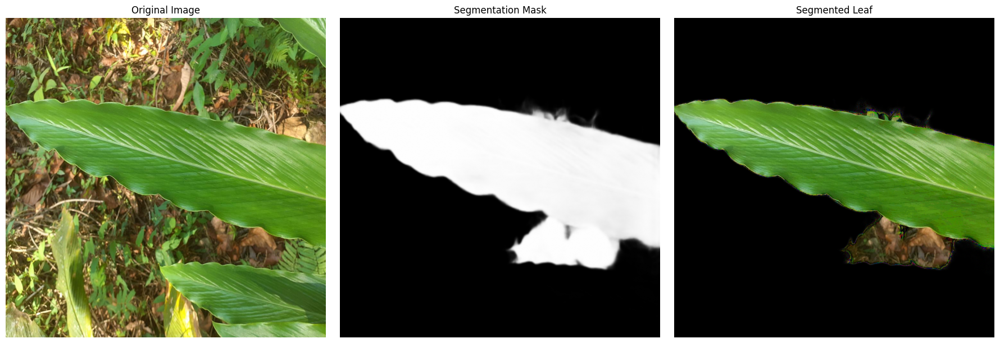

In [ ]:
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt

for idx, filename in enumerate(image_list[:10], 1):
    image_path = os.path.join(image_folder, filename)
    print(f"Processing ({idx}/5): {filename}")

    # Load and preprocess
    img = Image.open(image_path).convert("RGB")
    input_tensor = transform(img).unsqueeze(0)

    # Forward pass
    with torch.no_grad():
        d1, _, _, _, _, _, _ = net(input_tensor)
        pred = d1[:, 0, :, :]
        pred = (pred - pred.min()) / (pred.max() - pred.min())

    # Create mask and resize
    mask = (pred.squeeze().cpu().numpy() * 255).astype(np.uint8)
    orig = cv2.imread(image_path)
    orig_rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)  # convert for matplotlib
    mask_resized = cv2.resize(mask, (orig.shape[1], orig.shape[0]))

    # Apply mask
    segmented_leaf = cv2.bitwise_and(orig, cv2.merge([mask_resized]*3))
    segmented_leaf_rgb = cv2.cvtColor(segmented_leaf, cv2.COLOR_BGR2RGB)

    # Store results in pickle file
    # if filename not in all_results:
    #   all_results[filename] = {}
    # all_results[filename]["original_5"] = orig_rgb
    # all_results[filename]["mask_u2net"] = mask_resized
    # all_results[filename]["u2net_segmented"] = segmented_leaf_rgb

    # Display using matplotlib subplot
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    axes[0].imshow(orig_rgb)
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    axes[1].imshow(mask_resized, cmap='gray')
    axes[1].set_title("Segmentation Mask")
    axes[1].axis('off')

    axes[2].imshow(segmented_leaf_rgb)
    axes[2].set_title("Segmented Leaf")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
pickle_path = '/content/drive/MyDrive/dataset_1/segmentation_results.pkl'
with open(pickle_path, 'wb') as f:
    pickle.dump(all_results, f)

print(f"All segmentation results saved in pickle: {pickle_path}")

All segmentation results saved in pickle: /content/drive/MyDrive/dataset_1/segmentation_results.pkl


In [ ]:
results = {}
# loop over images, generate mask, save image, and maybe record in results dict
with open("segmentation_results.pkl", "wb") as f:
    pickle.dump(results, f)

In [ ]:
# import os
# import cv2
# import torch
# import numpy as np
# from torchvision import transforms
# from PIL import Image
# from model.u2net import U2NET

# # -----------------------------
# # Load U²-Net

# weight_path = "/content/drive/MyDrive/U2Net_weights/u2net.pth"
# net = U2NET(3, 1)
# net.load_state_dict(torch.load(weight_path, map_location="cpu"))
# net.eval()

# # -----------------------------
# # Input & Output Dataset Paths

# input_root = "/content/drive/MyDrive/dataset_1"       # original dataset
# output_root = "/content/drive/MyDrive/Segmented_Dataset"
# os.makedirs(output_root, exist_ok=True)

# splits = ["train", "test", "val"]   # lower-case for input folder
# classes = ["Healthy_1000", "Phylosticta_LS_1000"]  # add "Blight" if you need

# # -----------------------------
# # Preprocessing

# transform = transforms.Compose([
#     transforms.Resize((320, 320)),
#     transforms.ToTensor()
# ])

# # -----------------------------
# # Segmentation Function

# def segment_leaf(img_path):
#     img = Image.open(img_path).convert("RGB")
#     input_tensor = transform(img).unsqueeze(0)

#     with torch.no_grad():
#         d1, d2, d3, d4, d5, d6, d7 = net(input_tensor)  # unpack all
#         pred = d1[:, 0, :, :]                           # use d1
#         pred = (pred - pred.min()) / (pred.max() - pred.min() + 1e-8)

#     mask = (pred.squeeze().cpu().numpy() * 255).astype(np.uint8)

#     # Resize mask back to original size
#     orig = cv2.imread(img_path)
#     mask_resized = cv2.resize(mask, (orig.shape[1], orig.shape[0]))

#     # Apply mask
#     segmented = cv2.bitwise_and(orig, cv2.merge([mask_resized]*3))
#     return segmented

# # -----------------------------
# # Loop through dataset & save
# # -----------------------------
# for split in splits:
#     for cls in classes:
#         input_dir = os.path.join(input_root, split, cls)
#         output_dir = os.path.join(output_root, split.capitalize(), cls)
#         os.makedirs(output_dir, exist_ok=True)

#         if not os.path.exists(input_dir):
#             print(f"⚠️ Skipping {input_dir}, not found")
#             continue

#         for fname in os.listdir(input_dir):
#             in_path = os.path.join(input_dir, fname)
#             out_path = os.path.join(output_dir, fname)

#             if os.path.exists(out_path):
#                 continue  # already processed

#             # Check if the entry is a file before processing
#             if os.path.isfile(in_path):
#                 segmented_leaf = segment_leaf(in_path)
#                 if segmented_leaf is not None:
#                     cv2.imwrite(out_path, segmented_leaf)

# print("All segmented images saved into:", output_root)

In [ ]:
# import os
# import random
# import shutil

# # Path to your training dataset
# train_dir = "/content/drive/MyDrive/Segmented_Dataset/Train"

# # Target number of images per class
# TARGET_COUNT = 600

# # To avoid deleting raw originals accidentally:
# BACKUP_DIR = "/content/Segmented_Dataset/Backup"
# os.makedirs(BACKUP_DIR, exist_ok=True)

# def balance_dataset(train_dir, target_count):
#     for cls in os.listdir(train_dir):
#         cls_path = os.path.join(train_dir, cls)
#         if not os.path.isdir(cls_path):
#             continue

#         images = [f for f in os.listdir(cls_path) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
#         count = len(images)

#         print(f"🔹 Class: {cls} | Current: {count} | Target: {target_count}")

#         if count > target_count:
#             # Select extra images randomly for deletion
#             extra = count - target_count
#             to_delete = random.sample(images, extra)

#             # Move them to backup (instead of deleting permanently)
#             backup_cls = os.path.join(BACKUP_DIR, cls)
#             os.makedirs(backup_cls, exist_ok=True)

#             for img in to_delete:
#                 shutil.move(os.path.join(cls_path, img),
#                             os.path.join(backup_cls, img))

#             print(f"   ➤ {extra} extra images moved to backup for {cls}")

#         else:
#             print(f"   ✅ {cls} is within balance range (no removal needed).")

# # Run once
# balance_dataset(train_dir, TARGET_COUNT)

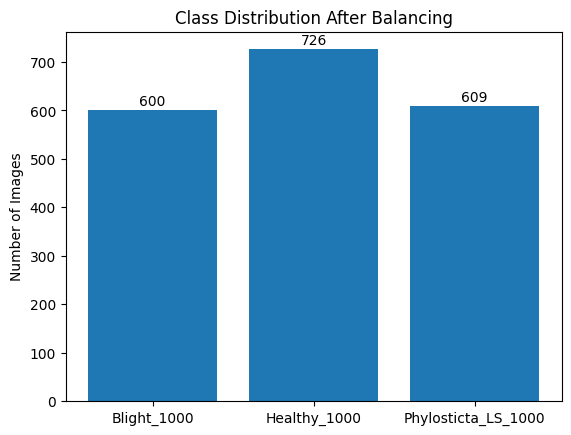

In [ ]:
import os
import matplotlib.pyplot as plt

train_path = "/content/drive/MyDrive/Segmented_Dataset/Train"
categories = ['Blight_1000', 'Healthy_1000', 'Phylosticta_LS_1000']
counts = [len(os.listdir(os.path.join(train_path, c))) for c in categories]

plt.bar(categories, counts)
plt.title('Class Distribution After Balancing')
plt.ylabel('Number of Images')
for i, v in enumerate(counts):
    plt.text(i, v + 10, str(v), ha='center')
plt.show()

In [ ]:
# import os
# import cv2
# import numpy as np
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tqdm import tqdm

# # Define your dataset paths
# base_dir = '/content/drive/MyDrive/Segmented_Dataset/'  # <-- change this path
# sets = ['Train', 'Val', 'Test']

# # Define target class and target augmentation count
# target_class = 'Blight_1000'
# target_counts = {'Train': 601, 'Val': 170, 'Test': 73}  # adjust to match H and P roughly

# # Define augmentation generator (light and realistic)
# datagen = ImageDataGenerator(
#     rotation_range=15,
#     width_shift_range=0.05,
#     height_shift_range=0.05,
#     zoom_range=0.1,
#     horizontal_flip=True,
#     brightness_range=[0.8, 1.2],
#     fill_mode='nearest'
# )

# def augment_images(folder_path, target_count):
#     images = [img for img in os.listdir(folder_path) if img.lower().endswith(('.png', '.jpg', '.jpeg'))]
#     current_count = len(images)

#     if current_count >= target_count:
#         print(f"✅ {folder_path} already has {current_count} images (>= target {target_count}). Skipping augmentation.")
#         return

#     augment_needed = target_count - current_count
#     print(f"⚙️ Augmenting {augment_needed} new images in {folder_path}...")

#     img_save_prefix = "aug_"
#     aug_index = 1

#     for img_name in tqdm(images, desc=f"Augmenting {os.path.basename(folder_path)}"):
#         img_path = os.path.join(folder_path, img_name)
#         img = cv2.imread(img_path)
#         if img is None:
#             continue
#         img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#         img = np.expand_dims(img, 0)

#         # Generate augmented images safely (no duplication)
#         for batch in datagen.flow(img, batch_size=1):
#             new_filename = f"{img_save_prefix}{aug_index:04d}.jpg"
#             new_path = os.path.join(folder_path, new_filename)
#             if not os.path.exists(new_path):  # ensures idempotency
#                 cv2.imwrite(new_path, cv2.cvtColor(batch[0].astype('uint8'), cv2.COLOR_RGB2BGR))
#                 aug_index += 1
#             if aug_index > augment_needed:
#                 break
#         if aug_index > augment_needed:
#             break

# for set_name in sets:
#     folder_path = os.path.join(base_dir, set_name, target_class)
#     augment_images(folder_path, target_counts[set_name])


Basic Machine Learning Models


*   SVM
*   KNN
*   Decision Tree
*   Random Forest




In [ ]:
import numpy as np
import os
from tensorflow.keras.preprocessing import image
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

# Path to your segmented dataset
data_dir = '/content/drive/MyDrive/Segmented_Dataset/Train'

# Class names (make sure these match your folder names)
classes = ['Healthy_1000', 'Blight_1000', 'Phylosticta_LS_1000']

# Initialize arrays
X = []
y = []

# Loop through all classes and images
for idx, label in enumerate(classes):
  folder = os.path.join(data_dir, label)
  for img_name in os.listdir(folder):
    img_path = os.path.join(folder, img_name)
    img = image.load_img(img_path, target_size=(224, 224)) # Resize for consistency
    img_array = image.img_to_array(img).flatten() # Convert to 1D feature vector
    X.append(img_array)
    y.append(idx)

# Convert to numpy arrays
X = np.array(X)
y = np.array(y)

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define models
models = {
    "SVM": SVC(),
    "KNN": KNeighborsClassifier(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier()
}

# Train and evaluate models
for name, model in models.items():
  model.fit(X_train, y_train)
  preds = model.predict(X_test)
  acc = accuracy_score(y_test, preds)
  print(f"\n{name} Accuracy: {acc:.4f}")
  print(confusion_matrix(y_test, preds))
  print(classification_report(y_test, preds, target_names=classes))


SVM Accuracy: 0.9225
[[139   3   7]
 [  2 108   2]
 [ 16   0 110]]
                     precision    recall  f1-score   support

       Healthy_1000       0.89      0.93      0.91       149
        Blight_1000       0.97      0.96      0.97       112
Phylosticta_LS_1000       0.92      0.87      0.90       126

           accuracy                           0.92       387
          macro avg       0.93      0.92      0.93       387
       weighted avg       0.92      0.92      0.92       387


KNN Accuracy: 0.8786
[[139   0  10]
 [  4 106   2]
 [ 29   2  95]]
                     precision    recall  f1-score   support

       Healthy_1000       0.81      0.93      0.87       149
        Blight_1000       0.98      0.95      0.96       112
Phylosticta_LS_1000       0.89      0.75      0.82       126

           accuracy                           0.88       387
          macro avg       0.89      0.88      0.88       387
       weighted avg       0.88      0.88      0.88       387


Dec

In [ ]:
from tqdm import tqdm # Import tqdm

def extract_features(img_path):
    """
    Basic example of feature extraction. You might need to replace this
    with a more sophisticated method depending on your image data and task.
    This example reads an image and flattens its pixel values as features.
    """
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not read image {img_path}")
        return None
    # Resize for consistency (optional, but good practice)
    img = cv2.resize(img, (64, 64)) # Example size
    # Convert to grayscale (optional)
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Flatten the image data
    features = img.flatten()
    return features

In [ ]:
# Use your same extract_features() function

def load_data(folder_path):
    X, y = [], []
    for label, cls in enumerate(classes):
        class_folder = os.path.join(folder_path, cls)
        for file in tqdm(os.listdir(class_folder), desc=f"Loading {cls}"):
            if file.lower().endswith((".jpg", ".jpeg", ".png")):
                fpath = os.path.join(class_folder, file)
                feat = extract_features(fpath)
                X.append(feat)
                y.append(label)
    return np.array(X), np.array(y)

# Update base paths correctly (you had "Train" nested once extra)
base_path = "/content/drive/MyDrive/Segmented_Dataset"
train_path = os.path.join(base_path, "Train")
val_path   = os.path.join(base_path, "Val")
test_path  = os.path.join(base_path, "Test")

# Load them
X_train, y_train = load_data(train_path)
X_val, y_val = load_data(val_path)
X_test, y_test = load_data(test_path)

print("Train:", X_train.shape, "Val:", X_val.shape, "Test:", X_test.shape)

Loading Phylosticta_LS_1000: 100%|██████████| 67/67 [00:00<00:00, 71.23it/s]

Train: (1935, 12288) Val: (528, 12288) Test: (219, 12288)


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Scale
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_val_scaled   = scaler.transform(X_val)
X_test_scaled  = scaler.transform(X_test)

# PCA - keep 95% variance
pca = PCA(n_components=0.95)
X_train_pca = pca.fit_transform(X_train_scaled)
X_val_pca   = pca.transform(X_val_scaled)
X_test_pca  = pca.transform(X_test_scaled)

print("Reduced dimension count:", X_train_pca.shape[1])


Reduced dimension count: 458


Tuning SVM and Random Forest with GridSearchCV

In [ ]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# --- SVM Tuning ---
param_grid_svm = {
    'C': [1, 10],
    'gamma': ['scale', 0.01],
    'kernel': ['rbf']
}
grid_svm = GridSearchCV(SVC(probability=True), param_grid_svm, cv=cv, scoring='accuracy', n_jobs=-1)
grid_svm.fit(X_train_pca, y_train)
print("Best SVM Params:", grid_svm.best_params_)
print("Best SVM CV Accuracy:", grid_svm.best_score_)

# --- Random Forest Tuning ---
param_grid_rf = {
    'n_estimators': [100, 200],
    'max_depth': [10, 20, None]
}
grid_rf = GridSearchCV(RandomForestClassifier(random_state=42), param_grid_rf, cv=cv, scoring='accuracy', n_jobs=-1)
grid_rf.fit(X_train_pca, y_train)
print("Best RF Params:", grid_rf.best_params_)
print("Best RF CV Accuracy:", grid_rf.best_score_)


Best SVM Params: {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}
Best SVM CV Accuracy: 0.9198966408268735
Best RF Params: {'max_depth': 10, 'n_estimators': 200}
Best RF CV Accuracy: 0.8609819121447029


In [ ]:
# Combaining SVM, Random Forest, KNN - Ensemble voting classifer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

svm_best = grid_svm.best_estimator_
rf_best = grid_rf.best_estimator_
knn = KNeighborsClassifier(n_neighbors=5)

voting_clf = VotingClassifier(
    estimators=[('svm', svm_best), ('rf', rf_best), ('knn', knn)],
    voting='soft'
)

voting_clf.fit(X_train_pca, y_train)

VotingClassifier(estimators=[('svm', SVC(C=10, probability=True)),
                             ('rf',
                              RandomForestClassifier(max_depth=10,
                                                     n_estimators=200,
                                                     random_state=42)),
                             ('knn', KNeighborsClassifier())],
                 voting='soft')

In [ ]:
# Validation
val_preds = voting_clf.predict(X_val_pca)
print("\nValidation Accuracy:", accuracy_score(y_val, val_preds))
print(confusion_matrix(y_val, val_preds))
print(classification_report(y_val, val_preds, target_names=classes))

# Test
test_preds = voting_clf.predict(X_test_pca)
print("\n Final Test Accuracy:", accuracy_score(y_test, test_preds))
print(confusion_matrix(y_test, test_preds))
print(classification_report(y_test, test_preds, target_names=classes))



Validation Accuracy: 0.7253787878787878
[[186   1   4]
 [107  43  20]
 [ 12   1 154]]
                     precision    recall  f1-score   support

       Healthy_1000       0.61      0.97      0.75       191
        Blight_1000       0.96      0.25      0.40       170
Phylosticta_LS_1000       0.87      0.92      0.89       167

           accuracy                           0.73       528
          macro avg       0.81      0.72      0.68       528
       weighted avg       0.80      0.73      0.68       528


 Final Test Accuracy: 0.634703196347032
[[72  1  6]
 [ 2 12 59]
 [11  1 55]]
                     precision    recall  f1-score   support

       Healthy_1000       0.85      0.91      0.88        79
        Blight_1000       0.86      0.16      0.28        73
Phylosticta_LS_1000       0.46      0.82      0.59        67

           accuracy                           0.63       219
          macro avg       0.72      0.63      0.58       219
       weighted avg       0.73      0

CNN

In [ ]:
# =============================================
# Custom CNN (3 Convolution Layers) - TensorFlow/Keras
# =============================================

import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models, optimizers, callbacks
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay

# ---------------------------------------------
# Dataset Paths
# ---------------------------------------------
DATA_DIR = "/content/drive/MyDrive/Segmented_Dataset"
TRAIN_DIR = os.path.join(DATA_DIR, "Train")
VAL_DIR   = os.path.join(DATA_DIR, "Val")
TEST_DIR  = os.path.join(DATA_DIR, "Test")

# ---------------------------------------------
# Hyperparameters
# ---------------------------------------------
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
SEED = 42
EPOCHS = 25

# ---------------------------------------------
# Data Generators (Augmentation + Normalization)
# ---------------------------------------------
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.15,
    height_shift_range=0.15,
    zoom_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_test_datagen = ImageDataGenerator(rescale=1./255)

train_gen = train_datagen.flow_from_directory(
    TRAIN_DIR, target_size=IMG_SIZE, batch_size=BATCH_SIZE,
    class_mode='categorical', seed=SEED
)

val_gen = val_test_datagen.flow_from_directory(
    VAL_DIR, target_size=IMG_SIZE, batch_size=BATCH_SIZE,
    class_mode='categorical', shuffle=False
)

test_gen = val_test_datagen.flow_from_directory(
    TEST_DIR, target_size=IMG_SIZE, batch_size=BATCH_SIZE,
    class_mode='categorical', shuffle=False
)

# ---------------------------------------------
# Compute Class Weights (for imbalance handling)
# ---------------------------------------------
y_train = []
for i in range(len(train_gen)):
    _, labels = train_gen[i]
    y_train.extend(np.argmax(labels, axis=1))
y_train = np.array(y_train)

if len(y_train) > 0:
    classes = np.unique(y_train)
    class_weights_vals = compute_class_weight('balanced', classes=classes, y=y_train)
    class_weights = {i: w for i, w in enumerate(class_weights_vals)}
    print("Class indices:", train_gen.class_indices)
    print("Class weights:", class_weights)
else:
    class_weights = None
    print("Warning: No training labels found. Class weights will not be used.")

# ---------------------------------------------
# Build Simplified 3-Layer CNN
# ---------------------------------------------
def build_custom_cnn(input_shape=(224,224,3), n_classes=3):
    inp = layers.Input(shape=input_shape)

    # 1st Conv Block
    x = layers.Conv2D(32, (3,3), activation='relu', padding='same')(inp)
    x = layers.MaxPooling2D((2,2))(x)

    # 2nd Conv Block
    x = layers.Conv2D(64, (3,3), activation='relu', padding='same')(x)
    x = layers.MaxPooling2D((2,2))(x)

    # 3rd Conv Block
    x = layers.Conv2D(128, (3,3), activation='relu', padding='same')(x)
    x = layers.MaxPooling2D((2,2))(x)

    # Fully Connected Layers
    x = layers.Flatten()(x)
    x = layers.Dense(128, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    out = layers.Dense(n_classes, activation='softmax')(x)

    model = models.Model(inputs=inp, outputs=out)
    return model

n_classes = len(train_gen.class_indices)
model = build_custom_cnn((IMG_SIZE[0], IMG_SIZE[1], 3), n_classes)
model.compile(optimizer=optimizers.Adam(1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

# ---------------------------------------------
# Callbacks
# ---------------------------------------------
ckpt_path = "/content/custom_cnn_best.h5"
cb = [
    callbacks.ModelCheckpoint(ckpt_path, save_best_only=True, monitor='val_accuracy', mode='max'),
    callbacks.EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
]

# ---------------------------------------------
# Train Model
# ---------------------------------------------
history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS,
    class_weight=class_weights,
    callbacks=cb
)

# ---------------------------------------------
# Evaluate on Test Data
# ---------------------------------------------
test_loss, test_acc = model.evaluate(test_gen)
print("Test accuracy:", test_acc)

# ---------------------------------------------
# Predictions
# ---------------------------------------------
y_pred_probs = model.predict(test_gen)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = test_gen.classes
class_labels = list(test_gen.class_indices.keys())

# ---------------------------------------------
# Confusion Matrix
# ---------------------------------------------
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap='Blues', values_format='d')
plt.title("Confusion Matrix - Custom 3-Layer CNN")
plt.show()

# ---------------------------------------------
# Classification Report
# ---------------------------------------------
print("\nClassification Report:\n")
print(classification_report(y_true, y_pred, target_names=class_labels))

# ---------------------------------------------
# Save Final Model
# ---------------------------------------------
model.save("/content/custom_cnn_final.h5")


Found 1935 images belonging to 3 classes.
Found 528 images belonging to 3 classes.
Found 219 images belonging to 3 classes.


KeyboardInterrupt: 

In [ ]:
# Evaluate the model on the test dataset
loss, accuracy = model.evaluate(test_gen)

print(f"Test Loss: {loss:.4f}")
print(f"Test Accuracy: {accuracy:.4f}")

7/7 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step - accuracy: 0.4811 - loss: 1.7831
Test Loss: 1.1880
Test Accuracy: 0.6484


Found 219 files belonging to 3 classes.
Found classes: ['Blight_1000', 'Healthy_1000', 'Phylosticta_LS_1000']
Tensor shape: (32, 224, 224, 3)
dtype: <dtype: 'float32'>
min: 0.0 max: 255.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 955ms/step


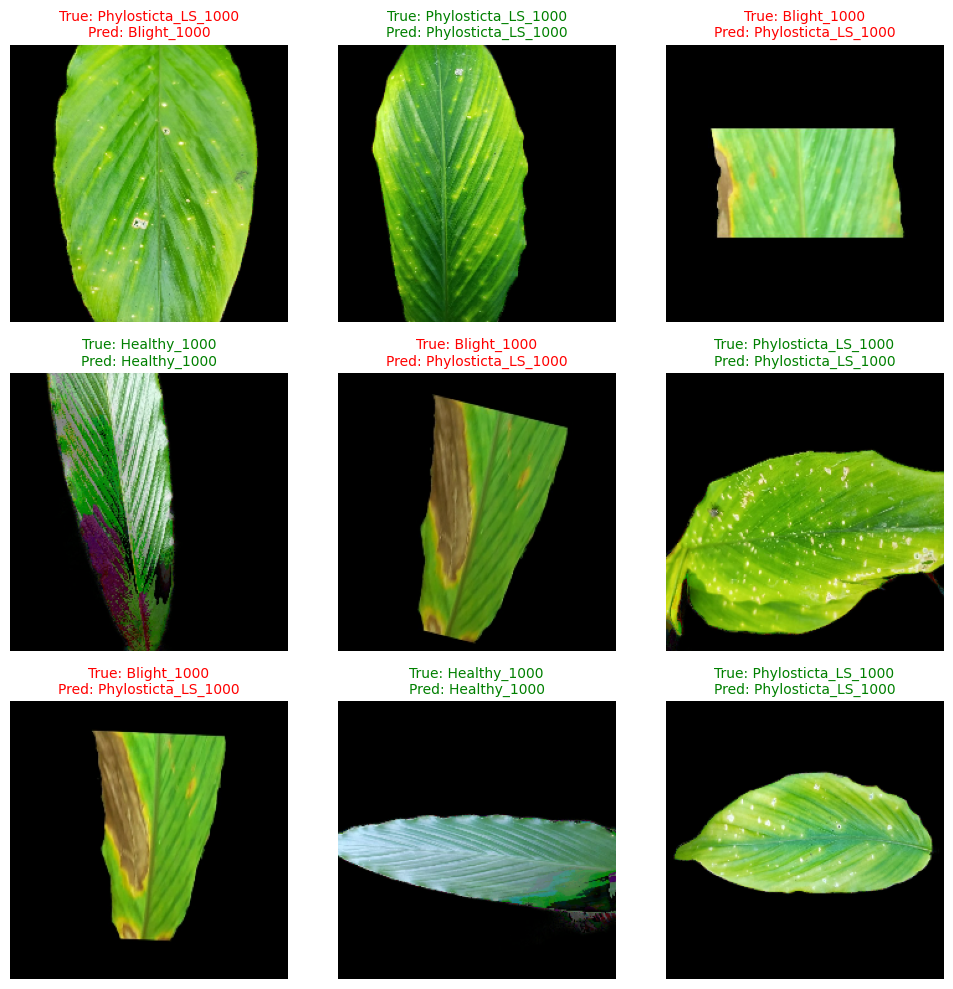


Example pixel values from first image (R channel, top-left 5x5):
tf.Tensor(
[[0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]], shape=(5, 5), dtype=float32)


In [ ]:
# =============================================
# A. Custom CNN (TensorFlow / Keras)
# =============================================

import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models, optimizers, callbacks
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay

# ---------------------------------------------
# Set paths (edit if needed)
# ---------------------------------------------
DATA_DIR = "/content/drive/MyDrive/Segmented_Dataset"
TRAIN_DIR = os.path.join(DATA_DIR, "Train")
VAL_DIR   = os.path.join(DATA_DIR, "Val")
TEST_DIR  = os.path.join(DATA_DIR, "Test")

# ---------------------------------------------
# Hyperparameters
# ---------------------------------------------
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
SEED = 42
EPOCHS = 25

# ---------------------------------------------
# Data generators (basic preprocessing + augmentation for training)
# ---------------------------------------------
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.15,
    height_shift_range=0.15,
    zoom_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_test_datagen = ImageDataGenerator(rescale=1./255)

train_gen = train_datagen.flow_from_directory(
    TRAIN_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    seed=SEED
)

val_gen = val_test_datagen.flow_from_directory(
    VAL_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

test_gen = val_test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# ---------------------------------------------
# Compute class weights to handle imbalance
# ---------------------------------------------
y_train = []
for i in range(len(train_gen)):
    _, labels = train_gen[i]
    y_train.extend(np.argmax(labels, axis=1))
y_train = np.array(y_train)

if len(y_train) > 0:
    classes = np.unique(y_train)
    class_weights_vals = compute_class_weight('balanced', classes=classes, y=y_train)
    class_weights = {i: w for i, w in enumerate(class_weights_vals)}
    print("Class indices:", train_gen.class_indices)
    print("Class weights:", class_weights)
else:
    class_weights = None
    print("Warning: No training labels found. Class weights will not be used.")

# ---------------------------------------------
# Build custom CNN
# ---------------------------------------------
def build_custom_cnn(input_shape=(224,224,3), n_classes=3):
    inp = layers.Input(shape=input_shape)
    x = layers.Conv2D(32, 3, activation='relu', padding='same')(inp)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPool2D(2)(x)

    x = layers.Conv2D(64, 3, activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPool2D(2)(x)

    x = layers.Conv2D(128, 3, activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.MaxPool2D(2)(x)

    x = layers.Flatten()(x)
    x = layers.Dense(256, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    out = layers.Dense(n_classes, activation='softmax')(x)

    model = models.Model(inputs=inp, outputs=out)
    return model

# ---------------------------------------------
# Compile model
# ---------------------------------------------
n_classes = len(train_gen.class_indices)
model = build_custom_cnn((IMG_SIZE[0], IMG_SIZE[1], 3), n_classes)
model.compile(optimizer=optimizers.Adam(1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

# ---------------------------------------------
# Callbacks
# ---------------------------------------------
ckpt_path = "/content/custom_cnn_best.h5"
cb = [
    callbacks.ModelCheckpoint(ckpt_path, save_best_only=True, monitor='val_accuracy', mode='max'),
    callbacks.EarlyStopping(monitor='val_loss', patience=6, restore_best_weights=True)
]

# ---------------------------------------------
# Train the model
# ---------------------------------------------
history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS,
    class_weight=class_weights,
    callbacks=cb
)

# ---------------------------------------------
# Evaluate on test set & predictions
# ---------------------------------------------
test_loss, test_acc = model.evaluate(test_gen)
print("Test accuracy:", test_acc)

y_pred_probs = model.predict(test_gen)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = test_gen.classes
class_labels = list(test_gen.class_indices.keys())

# ---------------------------------------------
# Confusion matrix and classification report
# ---------------------------------------------
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap='Blues', values_format='d')
plt.title("Confusion Matrix - Custom CNN")
plt.show()

print("\nClassification Report:\n")
print(classification_report(y_true, y_pred, target_names=class_labels))

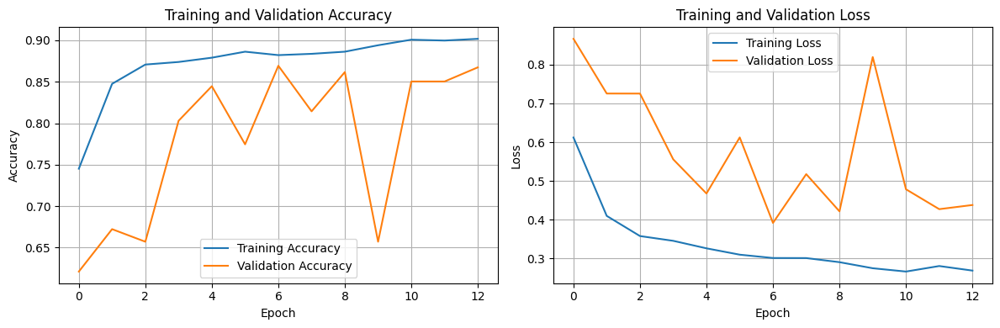

In [ ]:
# Plot training history
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# B. VGG19 Transfer Learning (Keras)
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models, optimizers, callbacks
from tensorflow.keras.applications import VGG19
from tensorflow.keras.applications.vgg19 import preprocess_input
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay

# Paths (edit if needed)
DATA_DIR = "/content/drive/MyDrive/Segmented_Dataset"
TRAIN_DIR = os.path.join(DATA_DIR, "Train")
VAL_DIR   = os.path.join(DATA_DIR, "Val") # Corrected path
TEST_DIR  = os.path.join(DATA_DIR, "Test")

IMG_SIZE = (224, 224)
BATCH_SIZE = 32
EPOCHS = 20
SEED = 42

# ImageDataGenerators: note preprocess_input for VGG19
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=30,
    width_shift_range=0.15,
    height_shift_range=0.15,
    zoom_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest'
)

val_test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

train_gen = train_datagen.flow_from_directory(
    TRAIN_DIR, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='categorical', seed=SEED
)

val_gen = val_test_datagen.flow_from_directory(
    VAL_DIR, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='categorical', shuffle=False
)

test_gen = val_test_datagen.flow_from_directory(
    TEST_DIR, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='categorical', shuffle=False
)

# class weights
y_train = train_gen.classes
classes = np.unique(y_train)
class_weights_vals = compute_class_weight('balanced', classes=classes, y=y_train)
class_weights = {i: w for i, w in enumerate(class_weights_vals)}
print("Class indices:", train_gen.class_indices)
print("Class weights:", class_weights)

# Build transfer model
base = VGG19(weights='imagenet', include_top=False, input_shape=(IMG_SIZE[0], IMG_SIZE[1], 3))
base.trainable = False  # freeze base

x = layers.GlobalAveragePooling2D()(base.output)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.5)(x)
out = layers.Dense(len(train_gen.class_indices), activation='softmax')(x)

vgg_model = models.Model(inputs=base.input, outputs=out)
vgg_model.compile(optimizer=optimizers.Adam(1e-4),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
vgg_model.summary()

# Callbacks
ckpt_vgg = "/content/vgg19_best.h5"
cbs = [
    callbacks.ModelCheckpoint(ckpt_vgg, save_best_only=True, monitor='val_accuracy', mode='max'),
    callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
]

# Train top layers first
history = vgg_model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS,
    class_weight=class_weights,
    callbacks=cbs
)

# Optionally unfreeze some of the top VGG blocks for fine-tuning
base.trainable = True
# Unfreeze last convolutional block only (e.g., block5)
set_trainable = False
for layer in base.layers:
    if layer.name.startswith('block5'):
        set_trainable = True
    layer.trainable = set_trainable

vgg_model.compile(optimizer=optimizers.Adam(1e-5),  # lower LR for fine-tune
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

ft_history = vgg_model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=10,
    class_weight=class_weights,
    callbacks=[
        callbacks.ModelCheckpoint("/content/vgg19_finetuned_best.h5", save_best_only=True, monitor='val_accuracy'),
        callbacks.EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True)
    ]
)

# Evaluate on test set
test_loss, test_acc = vgg_model.evaluate(test_gen)
print("VGG19 Test accuracy:", test_acc)

y_pred_probs = vgg_model.predict(test_gen)
y_pred = np.argmax(y_pred_probs, axis=1)
y_true = test_gen.classes
class_labels = list(test_gen.class_indices.keys())

cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap='Greens', values_format='d')
plt.title("Confusion Matrix - VGG19 (Fine-tuned)")
plt.show()

print("\nClassification Report:\n")
print(classification_report(y_true, y_pred, target_names=class_labels))

# Save model
vgg_model.save("/content/vgg19_final.h5")

Found 1935 images belonging to 3 classes.
Found 528 images belonging to 3 classes.
Found 219 images belonging to 3 classes.
Class indices: {'Blight_1000': 0, 'Healthy_1000': 1, 'Phylosticta_LS_1000': 2}
Class weights: {0: np.float64(1.075), 1: np.float64(0.8884297520661157), 2: np.float64(1.0591133004926108)}
80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv4 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv4 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv4 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │       262,656 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 20,288,579 (77.39 MB)

 Trainable params: 264,195 (1.01 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/61 ━━━━━━━━━━━━━━━━━━━━ 11:15 21s/step - accuracy: 0.3762 - loss: 2.5021

KeyboardInterrupt: 

In [ ]:
# -----------------------------
# Combine initial and fine-tune history
# -----------------------------
acc = history.history['accuracy'] + ft_history.history['accuracy']
val_acc = history.history['val_accuracy'] + ft_history.history['val_accuracy']

loss = history.history['loss'] + ft_history.history['loss']
val_loss = history.history['val_loss'] + ft_history.history['val_loss']

epochs_range = range(1, len(acc) + 1)

# -----------------------------
# Print final accuracies
# -----------------------------
print(f"Final Training Accuracy   : {acc[-1]:.4f}")
print(f"Final Validation Accuracy : {val_acc[-1]:.4f}")
print(f"Final Test Accuracy       : {test_acc:.4f}")

# -----------------------------
# Plot Accuracy Curve
# -----------------------------
plt.figure(figsize=(10, 5))
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.title("Epoch vs Accuracy (VGG19)")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()
plt.grid(True)
plt.show()

# -----------------------------
# Plot Loss Curve
# -----------------------------
plt.figure(figsize=(10, 5))
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.title("Epoch vs Loss (VGG19)")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.show()


In [ ]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

# ======= CONFIG =======
segmented_dataset_dir = "/content/drive/MyDrive/Segmented_Dataset"
segmented_test_dir = os.path.join(segmented_dataset_dir, "Test")
IMG_SIZE = (224, 224)   # change this if your model used a different size
BATCH_SIZE = 32

# ======= LOAD TEST DATASET =======
segmented_test_ds = tf.keras.utils.image_dataset_from_directory(
    segmented_test_dir,
    labels='inferred',
    label_mode='int',
    image_size=IMG_SIZE,
    batch_size=BATCH_SIZE
)

class_names = segmented_test_ds.class_names
print("Found classes:", class_names)

# ======= FETCH ONE BATCH =======
for images, labels in segmented_test_ds.take(1):
    print("Tensor shape:", images.shape)
    print("dtype:", images.dtype)
    print("min:", tf.reduce_min(images).numpy(), "max:", tf.reduce_max(images).numpy())

    # Make predictions
    predictions = model.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)

    # ---- Auto-normalize images for display ----
    def normalize_for_display(img):
        img = tf.convert_to_tensor(img)
        if tf.reduce_max(img) <= 1.0 and tf.reduce_min(img) >= 0.0:
            img = img * 255.0
        elif tf.reduce_min(img) < 0.0:   # scaled in [-1,1]
            img = (img + 1.0) * 127.5
        img = tf.clip_by_value(img, 0, 255)
        return tf.cast(img, tf.uint8).numpy()

    # ======= VISUALIZATION =======
    plt.figure(figsize=(10, 10))
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        img_disp = normalize_for_display(images[i])
        plt.imshow(img_disp)
        true_label = class_names[labels[i]]
        pred_label = class_names[predicted_labels[i]]
        color = 'green' if true_label == pred_label else 'red'
        plt.title(f"True: {true_label}\nPred: {pred_label}", color=color, fontsize=10)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

    # ======= DEBUG PRINT (OPTIONAL) =======
    print("\nExample pixel values from first image (R channel, top-left 5x5):")
    print(images[0][:5, :5, 0])
    break
